# 初期ノード除去方法での比較

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


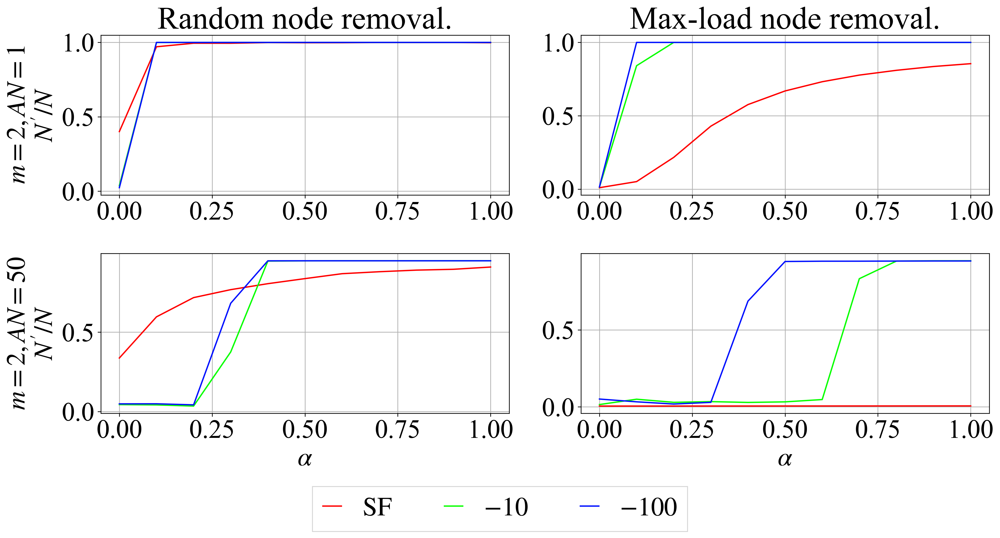

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


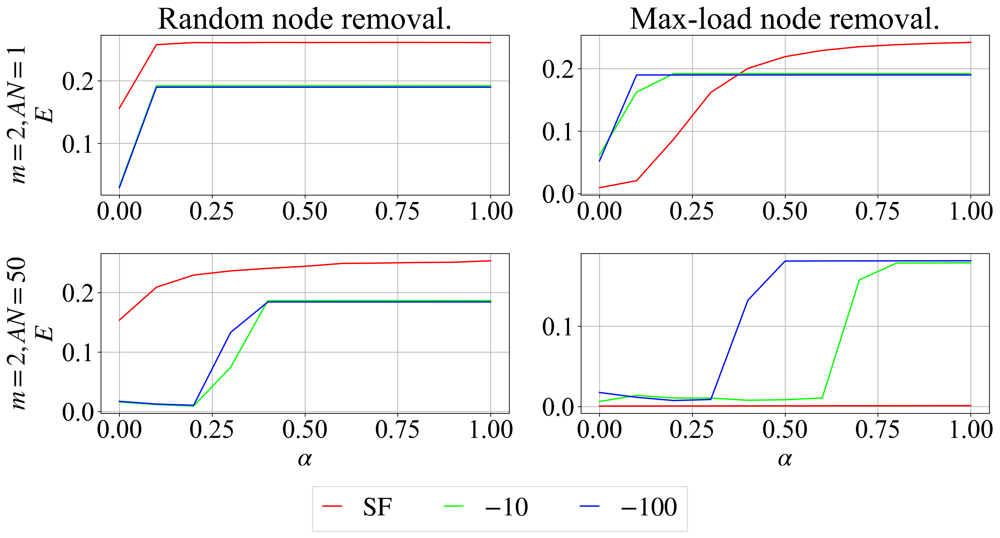

In [11]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# import os
# from pprint import pprint
# pprint(os.environ['PATH'])
# os.environ['PATH'] = os.environ['PATH'] + ':/Library/TeX/texbin/'
# os.environ['PATH'] = os.environ['PATH'] + ':/opt/homebrew/bin/'
# os.environ['PATH'] = os.environ['PATH'] + ':/Library/TeX/texbin/'

datadir = "./data/result/"

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, -10, -100]
config = True

config_str = "" if config else "_no_config"

nrs = ["random", "l_max"]

c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)

colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]


# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8  # 凡例の線と文字の距離の長さ
plt.rcParams["legend.markerscale"] = 1  # 点がある場合のmarker scale
plt.rcParams["legend.fontsize"] = 29
# plt.rcParams["ps.useafm"] = True
# plt.rcParams["pdf.use14corefonts"] = True
# plt.rcParams["text.usetex"] = True
plt.rcParams['figure.dpi'] = 300

for tg in ["R", "E"]:
    tg_label = "N'/N" if tg == "R" else "E"

    # 最大連結成分比
    ys = 2
    xs = 2
    fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

    fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

    ax[0][0].set_title("Random node removal.")
    # ax[0][1].set_title("max degree")
    ax[0][1].set_title("Max-load node removal.")

    for y, (m, an) in enumerate(itertools.product(ms, ans)):
        ax[ys-1][0].set_xlabel(r"$\alpha$")
        ax[y][0].set_ylabel(fr"$m = {m}, AN = {an}$""\n"fr"${tg_label}$")
        for i in range(1, len(nrs)):
            ax[ys-1][i].set_xlabel(r"$\alpha$")
            # ax[y][i].set_ylabel("G")

        # for i in range(len(nrs)):
        #     ax[y][i].set_ylim(0.0, 1.05)

        # コンフィグありの結果
        for clr_i, b in enumerate(bs):
            for i, nr in enumerate(nrs):
                df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{nr}_b{b}_AN{an}.csv", index_col=0)
                mean = []
                for a in aa:
                    mean.append(
                        sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)])
                        / number_of_network
                    )

                l = fr"${b}$"
                if b == 1:
                    l = r"$\rm{SF}$"

                # ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=l, color=cm.hsv(clr_i / len(bs)))
                ax[y][i].plot(np.arange(0, 1.1, 0.1), mean, label=l, color=cm.hsv(clr_i / len(bs)))

        # コンフィグなしの結果
        # for clr_i, b in enumerate(bs):
        #     try:
        #         for i, nr in enumerate(nrs):
        #             df = pd.read_csv(datadir + f"cf_n{node_size}_m{m}_b{b}_{nr}_AN{an}{config_str}_0.csv", index_col=0)
        #             mean = np.array(df.loc[aa, tg]) / number_of_network
        #             for j in range(1, number_of_network):
        #                 df = pd.read_csv(datadir + f"cf_n{node_size}_m{m}_b{b}_{nr}_AN{an}{config_str}_{j}.csv", index_col=0)
        #                 mean += np.array(df.loc[aa, tg]) / number_of_network

        #             l = fr"${b}$"
        #             if b == 1:
        #                 l = r"$\rm{SF}$"

        #             ax[y][i].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=l, color=cm.hsv(clr_i / len(bs)))
        #             # ax[y][i].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=l, color=colors[clr_i], cmap="Greys")
        #     except FileNotFoundError as e:
        #         print(e)

    lines, labels = fig.axes[-1].get_legend_handles_labels()
    # ax[0][0].legend()
    fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.05), ncol=4)

    fig.savefig(f'./img/{tg}_m{m}{config_str}-hayashi-color.eps', bbox_inches="tight", pad_inches=0.05)
    plt.show()

    # import os
    # os.system(f"ebb {tg}.pdf")




# Localized attackかどうかでの比較

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


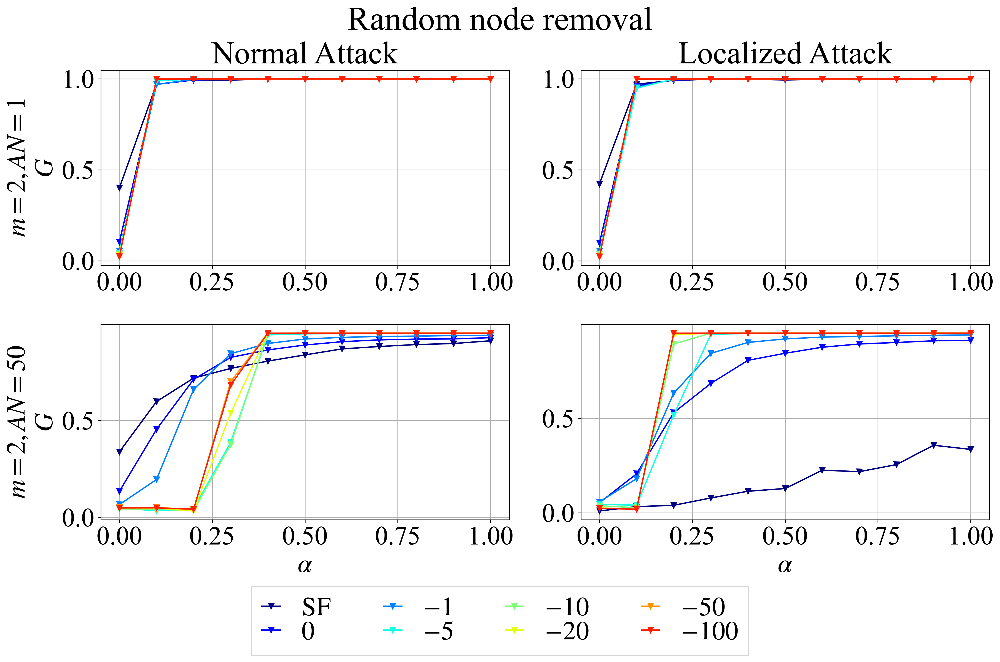

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


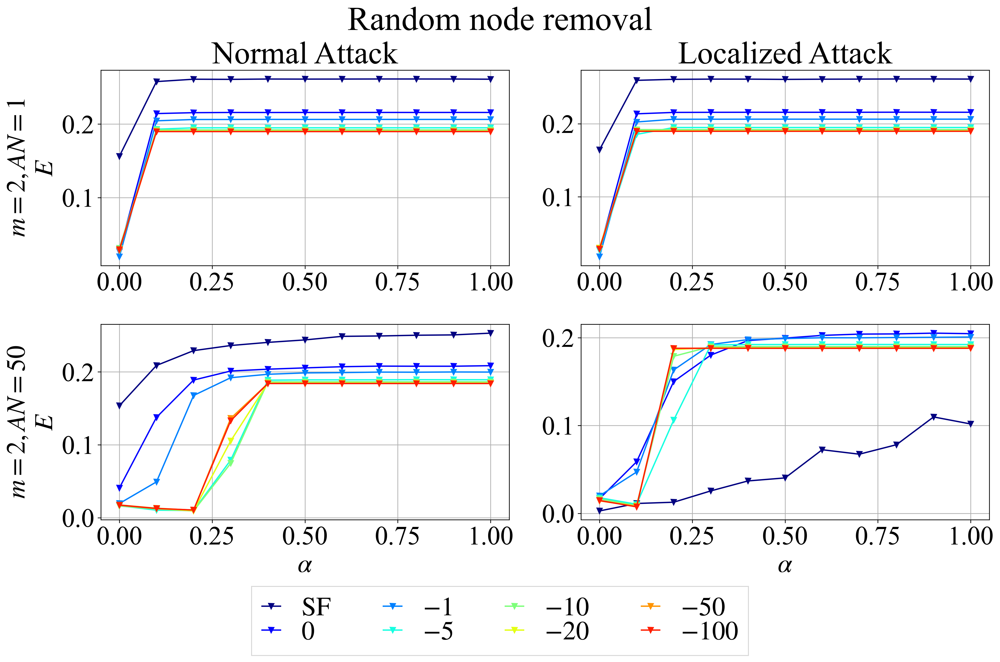

In [9]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# import os
# from pprint import pprint
# pprint(os.environ['PATH'])
# os.environ['PATH'] = os.environ['PATH'] + ':/Library/TeX/texbin/'
# os.environ['PATH'] = os.environ['PATH'] + ':/opt/homebrew/bin/'
# os.environ['PATH'] = os.environ['PATH'] + ':/Library/TeX/texbin/'

datadir = "./data/"

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

nr = "random"

c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)

colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8  # 凡例の線と文字の距離の長さ
plt.rcParams["legend.markerscale"] = 1  # 点がある場合のmarker scale
plt.rcParams["legend.fontsize"] = 29
# plt.rcParams["ps.useafm"] = True
# plt.rcParams["pdf.use14corefonts"] = True
# plt.rcParams["text.usetex"] = True
plt.rcParams['figure.dpi'] = 300

for tg in ["R", "E"]:
    tg_label = "G" if tg == "R" else "E"

    # 最大連結成分比
    ys = 2
    xs = 2
    fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))

    fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

    ax[0][0].set_title("Normal Attack")
    # ax[0][1].set_title("max degree")
    ax[0][1].set_title("Localized Attack")

    for y, (m, an) in enumerate(itertools.product(ms, ans)):
        ax[ys-1][0].set_xlabel(r"$\alpha$")
        ax[y][0].set_ylabel(fr"$m = {m}, AN = {an}$""\n"fr"${tg_label}$")
        for i in range(1, len(nrs)):
            ax[ys-1][i].set_xlabel(r"$\alpha$")
            # ax[y][i].set_ylabel("G")

        # for i in range(len(nrs)):
        #     ax[y][i].set_ylim(0.0, 1.05)

        for clr_i, b in enumerate(bs):
            try:
                df = pd.read_csv(datadir + f"result_config/result_n{node_size}_m{m}_{nr}_b{b}_AN{an}.csv", index_col=0)
                mean = []
                for a in aa:
                    mean.append(
                        sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)])
                        / number_of_network
                    )

                l = fr"${b}$"
                if b == 1:
                    l = r"$\rm{SF}$"

                ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=l, color=colors[clr_i])

                df = pd.read_csv(datadir + f"result_localized_config/result_n{node_size}_m{m}_{nr}_b{b}_AN{an}.csv", index_col=0)
                mean = []
                for a in aa:
                    mean.append(
                        sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)])
                        / number_of_network
                    )

                l = fr"${b}$"
                if b == 1:
                    l = r"$\rm{SF}$"

                ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=l, color=colors[clr_i])
            except FileNotFoundError as e:
                print(e)

    lines, labels = fig.axes[-1].get_legend_handles_labels()
    # ax[0][0].legend()
    fig.legend(lines, labels, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=4)

    nr_title = "Random"
    if nr == "k_max":
        nr_title = "Max-degree"
    elif nr == "l_max":
        nr_title = "Max-load"
    fig.suptitle(f'{nr_title} node removal', x=0.5, y=0.92, fontsize=37)
    # plt.subplots_adjust(left=0, right=0, bottom=0, top=-10)
    fig.savefig(f'./img/{tg}_n{node_size}_m{m}_b{b}_{nr}_localized.eps', bbox_inches="tight", pad_inches=0.05)
    plt.show()

    # import os
    # os.system(f"ebb {tg}.pdf")




# Configuration modelの有無での比較

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


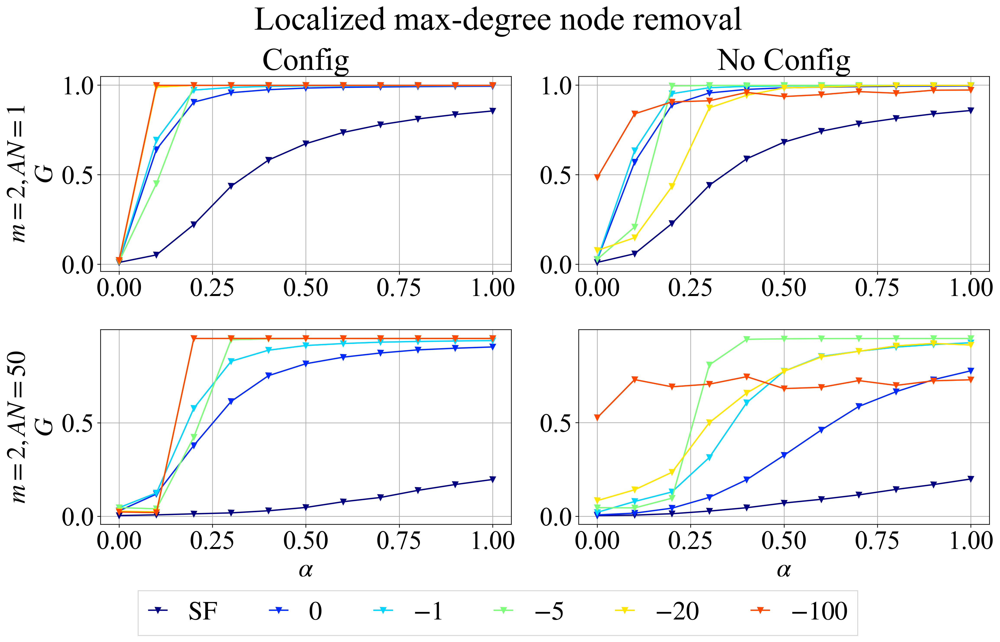

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


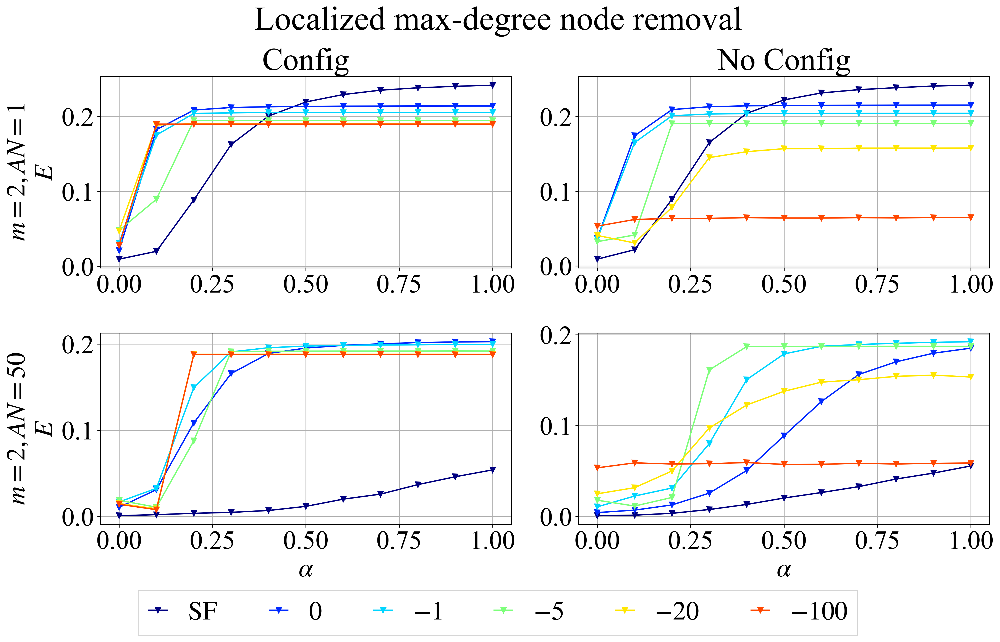

In [4]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -20, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "localized_k_max"

_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

for tg in ["R", "E"]:
    tg_label = "G" if tg == "R" else "E"

    # 最大連結成分比
    ys, xs = 2, 2
    fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))

    fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

    ax[0][0].set_title("Config")
    ax[0][1].set_title("No Config")

    for y, (m, an) in enumerate(itertools.product(ms, ans)):
        ax[ys-1][0].set_xlabel(r"$\alpha$")
        ax[ys-1][1].set_xlabel(r"$\alpha$")
        ax[y][0].set_ylabel(fr"$m = {m}, AN = {an}$""\n"fr"${tg_label}$")

        for clr_i, b in enumerate(bs):
            label = fr"${b}$" if not b == 1 else r"$\rm{SF}$"

            # apply configuration model
            if _localized:
                df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
            else:
                df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
            mean = [sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
            ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=label, color=colors[clr_i])

            # no configuration model
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
            mean = np.array(df.loc[aa, tg]) / number_of_network
            for j in range(1, number_of_network):
                df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
                mean += np.array(df.loc[aa, tg]) / number_of_network
            ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="v", label=label, color=colors[clr_i])

    lines, labels = fig.axes[-1].get_legend_handles_labels()
    # ax[0][0].legend()
    fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.05), ncol=6)

    match selection_of_node_removal:
        case "random":
            title = "Random"
        case "k_max":
            title = "Max-degree"
        case "l_max":
            title = "Max-load"
        case "localized_random":
            title = "Localized random"
        case "localized_k_max":
            title = "Localized max-degree"
        case "localized_l_max":
            title = "Localized max-load"
    fig.suptitle(f'{title} node removal', x=0.5, y=0.93, fontsize=37)

    fig.savefig(f'./img/config_or_noconfig_{title.replace(" ", "_")}_{tg}_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
    plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


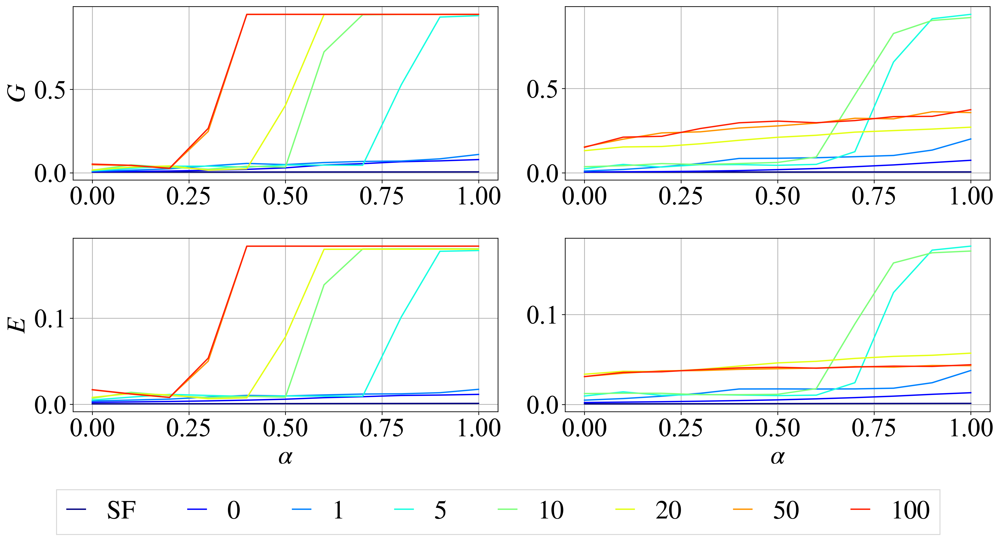

In [5]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "k_max"

_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

tg = "R"
tg_label = "G" if tg == "R" else "E"

# 最大連結成分比
ys, xs = 2, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

for y, (m, an) in enumerate(itertools.product(ms, ans)):
    ax[ys-1][0].set_xlabel(r"$\alpha$")
    ax[ys-1][1].set_xlabel(r"$\alpha$")
    ax[y][0].set_ylabel(fr"${tg_label}$")

    for clr_i, b in enumerate(bs):
        label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"

        # apply configuration model
        if _localized:
            df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        else:
            df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        mean = [sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
        ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

        # no configuration model
        df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
        mean = np.array(df.loc[aa, tg]) / number_of_network
        for j in range(1, number_of_network):
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
            mean += np.array(df.loc[aa, tg]) / number_of_network
        ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

tg = "E"
tg_label = "G" if tg == "R" else "E"

for y, (m, an) in enumerate(itertools.product(ms, ans)):
    ax[ys-1][0].set_xlabel(r"$\alpha$")
    ax[ys-1][1].set_xlabel(r"$\alpha$")
    ax[y+len(ans)][0].set_ylabel(fr"${tg_label}$")

    for clr_i, b in enumerate(bs):
        label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"

        # apply configuration model
        if _localized:
            df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        else:
            df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        mean = [sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
        ax[y+len(ans)][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

        # no configuration model
        df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
        mean = np.array(df.loc[aa, tg]) / number_of_network
        for j in range(1, number_of_network):
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
            mean += np.array(df.loc[aa, tg]) / number_of_network
        ax[y+len(ans)][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

lines, labels = fig.axes[-1].get_legend_handles_labels()
# ax[0][0].legend()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.04), ncol=8)

match selection_of_node_removal:
    case "random":
        title = "Random"
    case "k_max":
        title = "Max-degree"
    case "l_max":
        title = "Max-load"
    case "localized_random":
        title = "Localized random"
    case "localized_k_max":
        title = "Localized max-degree"
    case "localized_l_max":
        title = "Localized max-load"
# fig.suptitle(f'{title} node removal', x=0.5, y=0.96, fontsize=37)

fig.savefig(f'./img/config_or_noconfig_{title.replace(" ", "_")}_GE_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

# 条件ごとのRobustnessとEfficiencyの比較

2 random


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


2 k_max


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


2 l_max


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


2 localized_random


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


2 localized_k_max


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


2 localized_l_max


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


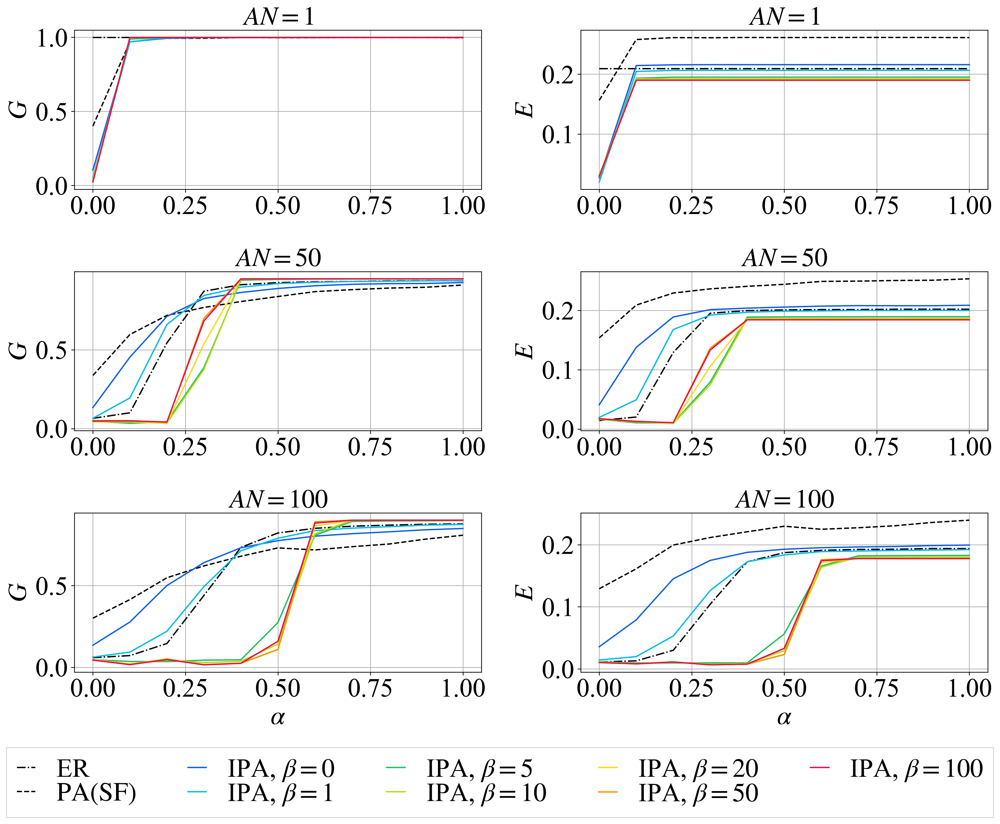

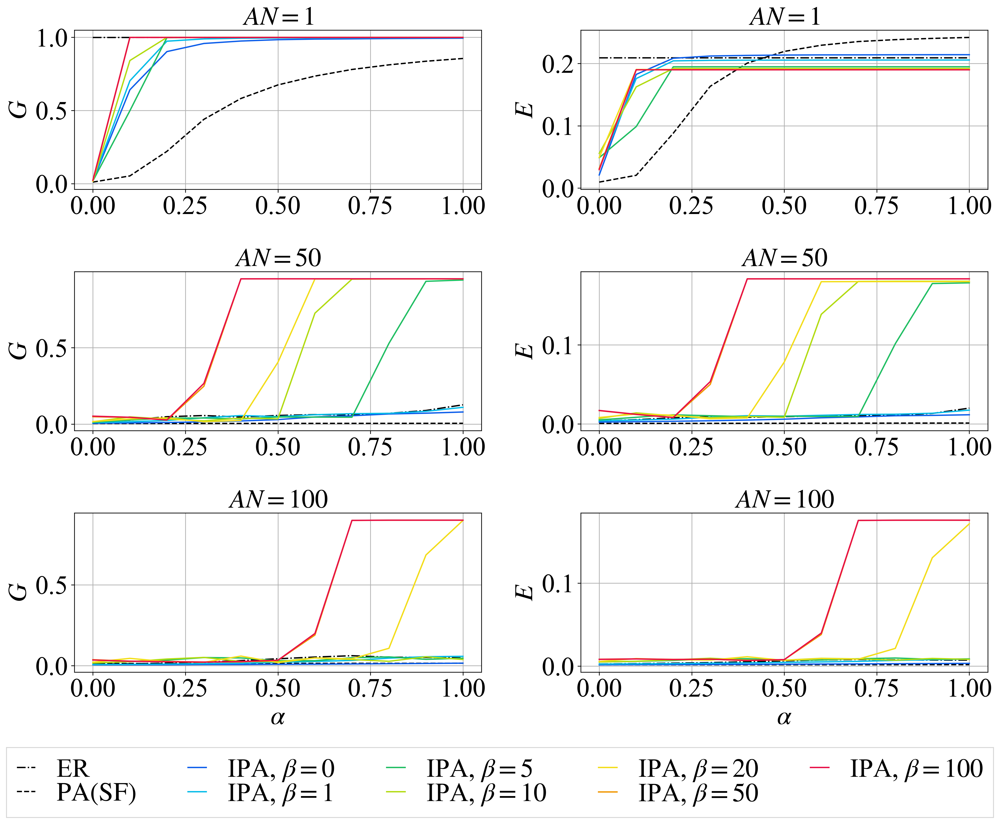

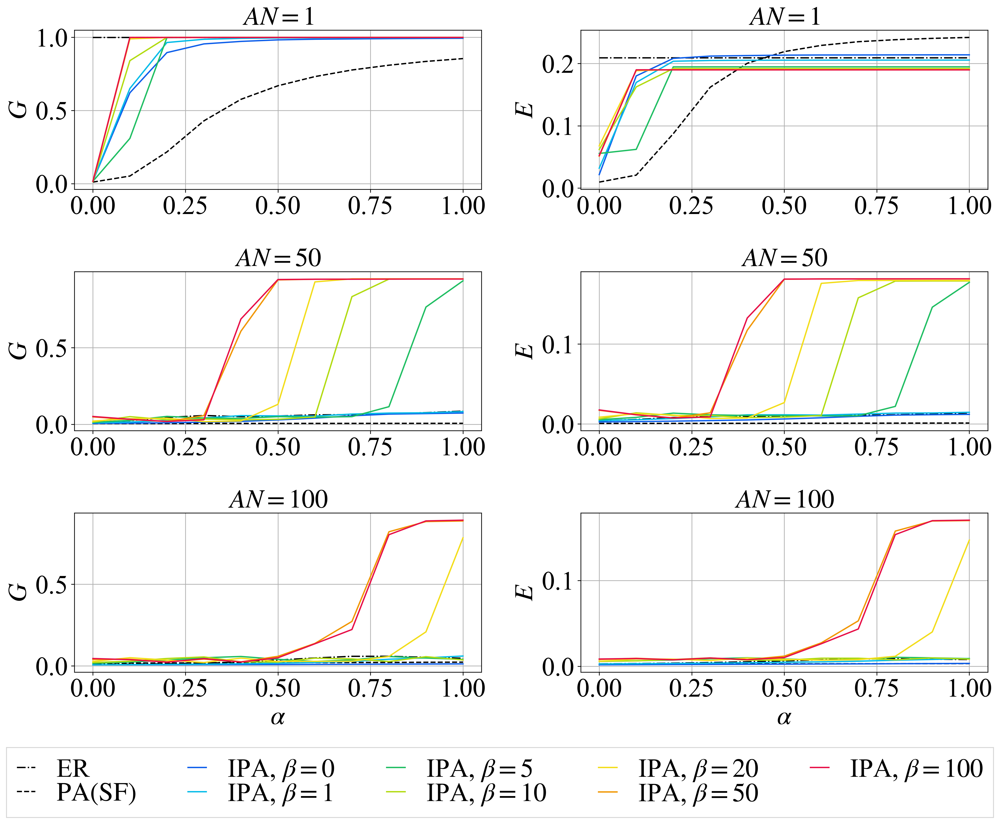

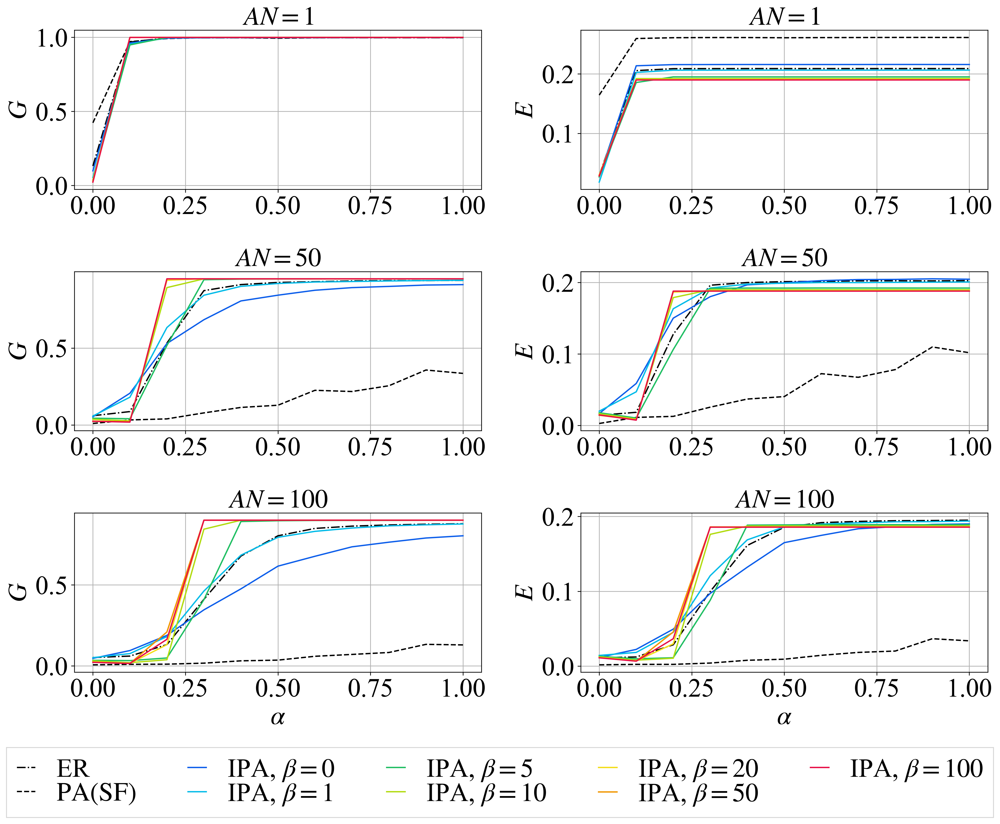

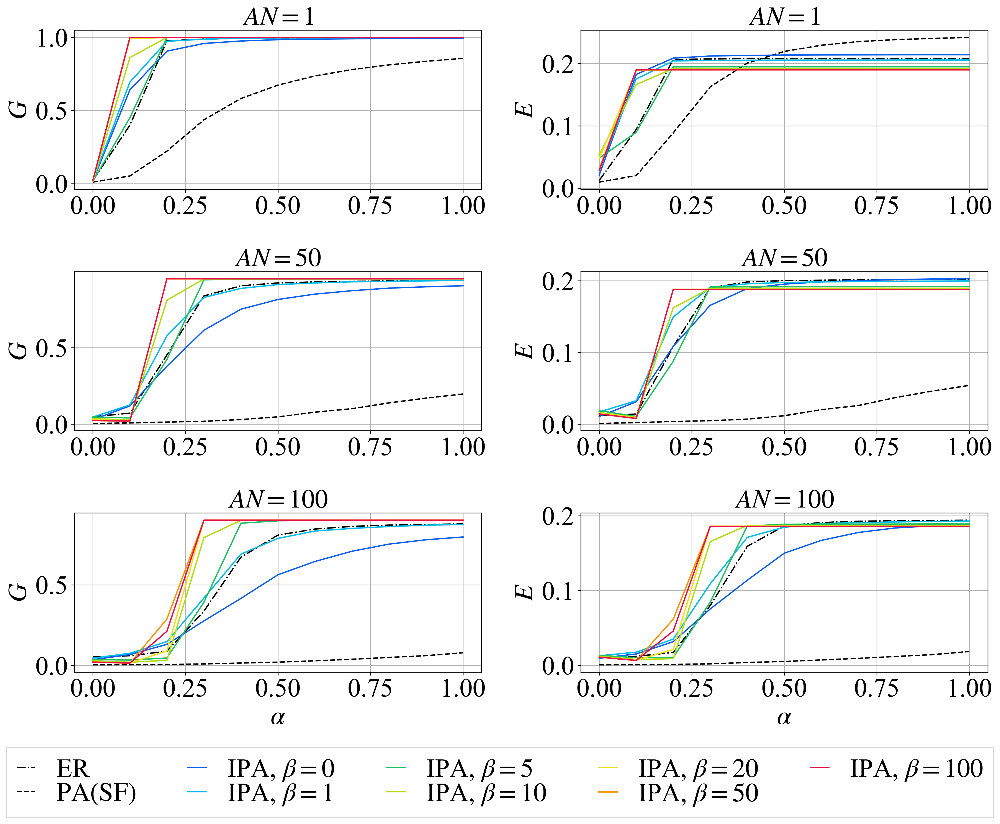

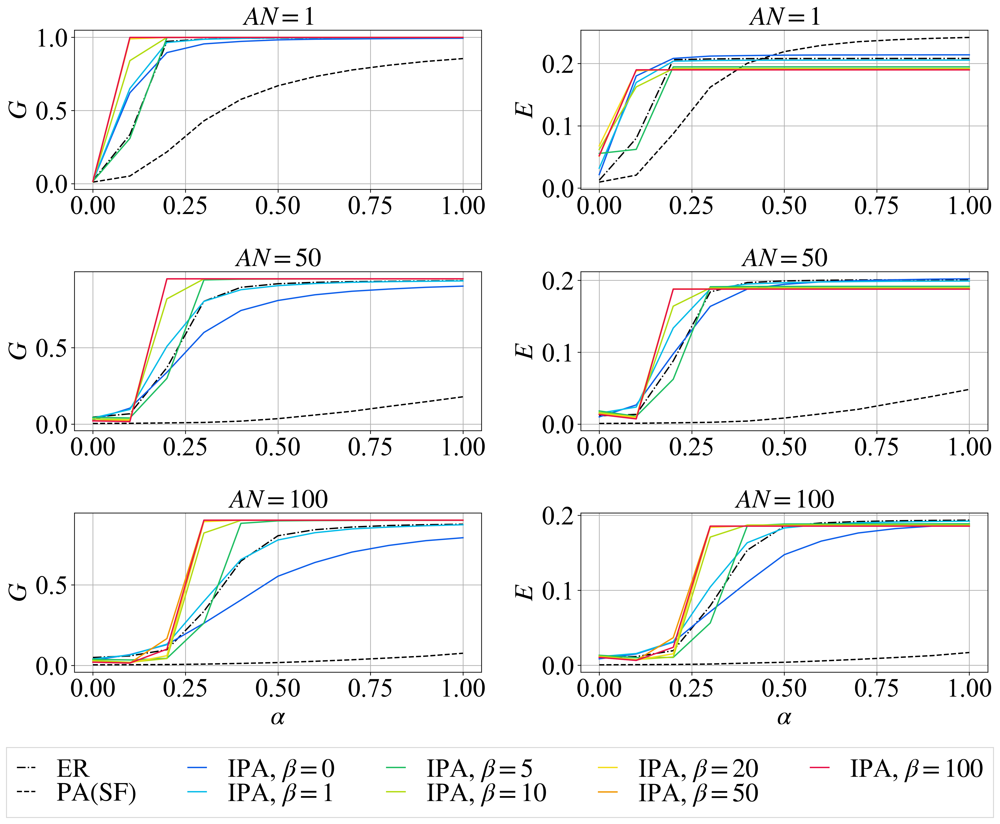

In [4]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50, 100]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

colors = [
    "",
    "#0d5eea",
    "#03BBE8",
    "#1FBE62",
    "#b2db11",
    "#f3dd1a",
    "#f19601",
    "#e70f47",
]


selections_of_node_removal = [
  "random",
  "k_max",
  "l_max",
  "localized_random",
  "localized_k_max",
  "localized_l_max",
]
ER_selections_of_node_removal = [
  "random",
  "k_max",
  "l_max",
  "random_localized",
  "k_max_localized",
  "l_max_localized",
]

for m, selection_of_node_removal in itertools.product(ms, selections_of_node_removal):
    print(m, selection_of_node_removal)

    _localized = True if selection_of_node_removal[0:9] == "localized" else False
    if _localized:
        _initial_node_removal = selection_of_node_removal[10:]
        _node_removal_filename = _initial_node_removal + "_localized"
    else:
        _initial_node_removal = selection_of_node_removal
        _node_removal_filename = _initial_node_removal

    tg = "R"
    tg_label = "G" if tg == "R" else "E"

    # 最大連結成分比
    ys, xs = 3, 2
    fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

    fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

    # ax[0][0].set_title("Robustness")
    # ax[0][1].set_title("Efficiency")

    for y, an in enumerate(ans):
        ax[ys-1][0].set_xlabel(r"$\alpha$")
        ax[ys-1][1].set_xlabel(r"$\alpha$")
        ax[y][0].set_ylabel(fr"$G$")
        # ax[y][0].set_ylabel(fr"$m = {m}, AN = {an}$""\n"fr"$R$")
        ax[y][1].set_ylabel(fr"$E$")

        if selection_of_node_removal[1] == "o":
            ER_removal = selection_of_node_removal[10:] + "_localized"
        else:
            ER_removal = selection_of_node_removal

        df = pd.read_csv(f"./data/ER/res/n1000/{ER_removal}/AN{an}/g_0.003974_0.csv", index_col=0)
        mean = np.array(df.loc[aa, "R"]) / number_of_network
        for j in range(1, number_of_network):
            df = pd.read_csv(f"./data/ER/res/n1000/{ER_removal}/AN{an}/g_0.003974_{j}.csv", index_col=0)
            mean += np.array(df.loc[aa, "R"]) / number_of_network
        ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color="black")

        df = pd.read_csv(f"./data/ER/res/n1000/{ER_removal}/AN{an}/g_0.003974_0.csv", index_col=0)
        mean = np.array(df.loc[aa, "E"]) / number_of_network
        for j in range(1, number_of_network):
            df = pd.read_csv(f"./data/ER/res/n1000/{ER_removal}/AN{an}/g_0.003974_{j}.csv", index_col=0)
            mean += np.array(df.loc[aa, "E"]) / number_of_network
        ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color="black")

        for clr_i, b in enumerate(bs):
            if b == 1:
                label = r"$\rm{PA(SF)}$"
            elif b == 0:
                label = r"IPA, $\beta=0$"
            else:
                label = fr"IPA, $\beta={b*-1}$"

            # R apply configuration model
            if _localized:
                df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
            else:
                df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
            mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]

            ax[y][0].set_title(fr"$AN = {an}$", fontsize=29)
            if b == 1:
                label = r"$\rm{PA(SF)}$"
            elif b == 0:
                label = r"IPA, $\beta=0$"
            else:
                label = fr"IPA, $\beta={b*-1}$"

            if b == 1:
                ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
            else:
                ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

            # E apply configuration model
            if _localized:
                df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
            else:
                df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
            mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]

            ax[y][1].set_title(fr"$AN = {an}$", fontsize=29)
            label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{PA(SF)}$"
            if b == 1:
                ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
            else:
                ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

    tg = "E"
    tg_label = "G" if tg == "R" else "E"

    lines, labels = fig.axes[-1].get_legend_handles_labels()
    # ax[0][0].legend()
    fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.03), ncol=5)

    match selection_of_node_removal:
        case "random":
            title = "Random"
        case "k_max":
            title = "Max-degree"
        case "l_max":
            title = "Max-load"
        case "localized_random":
            title = "Localized random"
        case "localized_k_max":
            title = "Localized max-degree"
        case "localized_l_max":
            title = "Localized max-load"
    # fig.suptitle(f'{title} node removal', x=0.5, y=0.93, fontsize=37)

    fig.savefig(f'./img/appendix/{title.replace(" ", "_")}_RE_config_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
    # plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


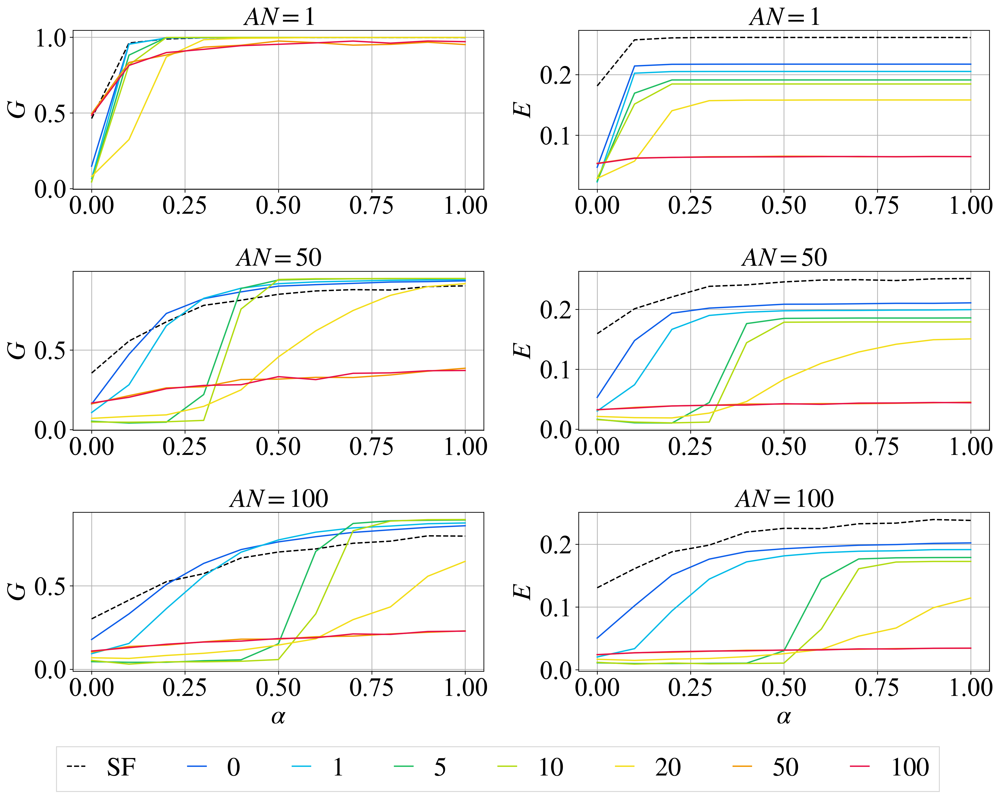

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


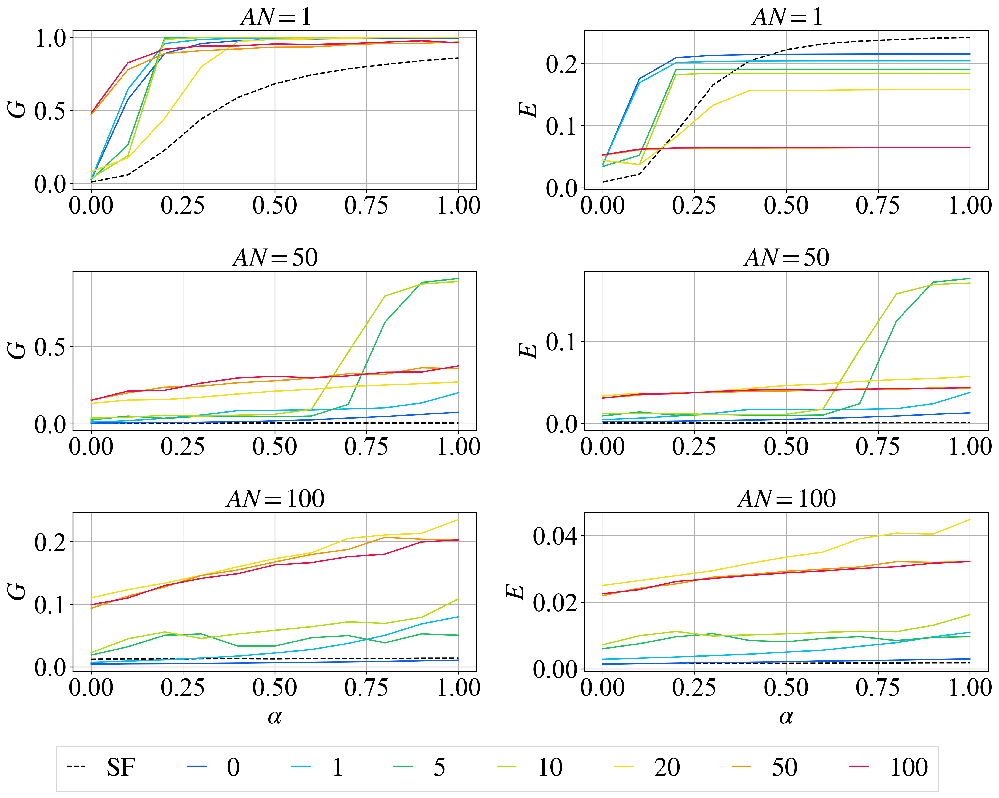

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


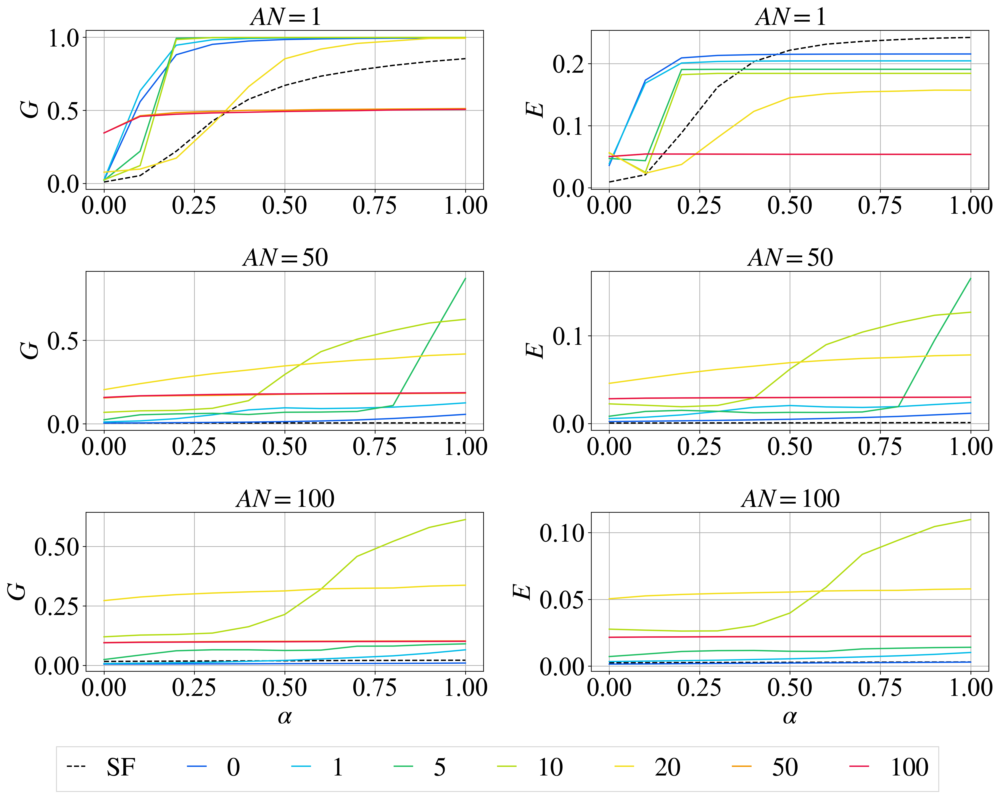

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


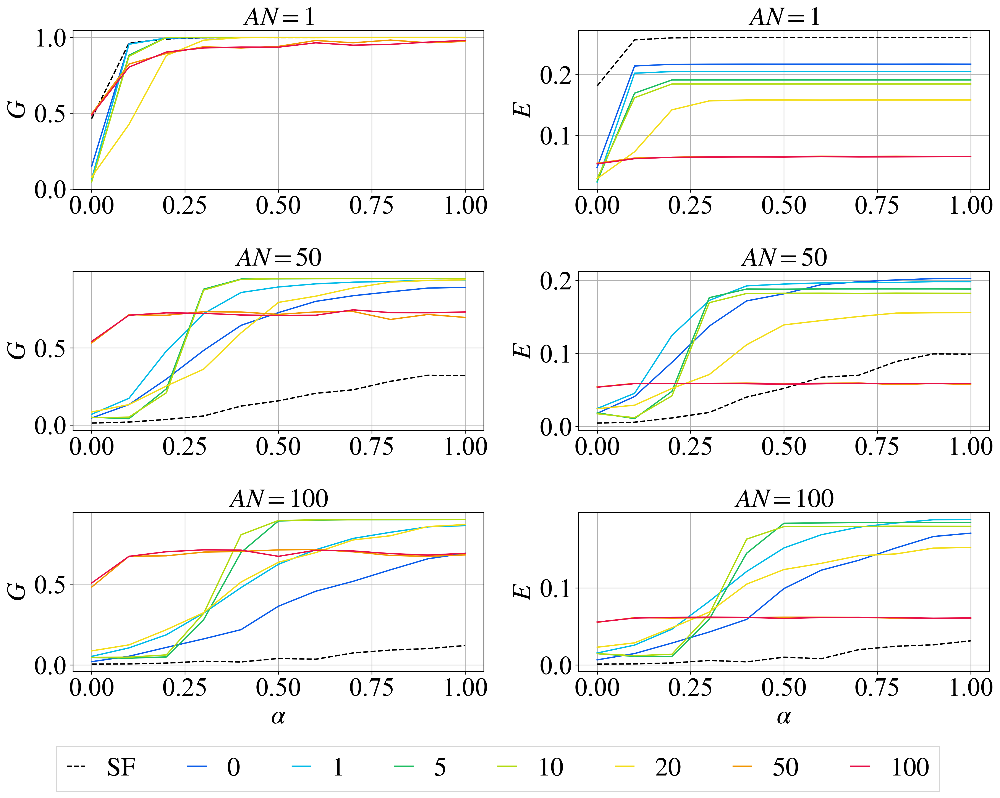

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


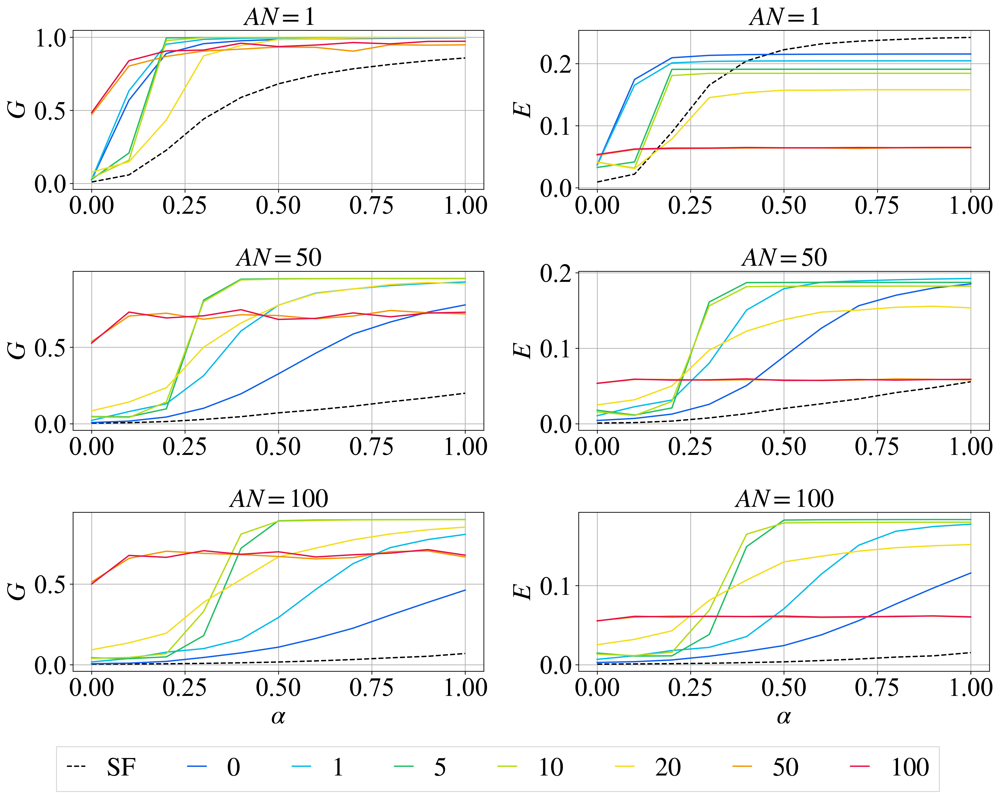

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


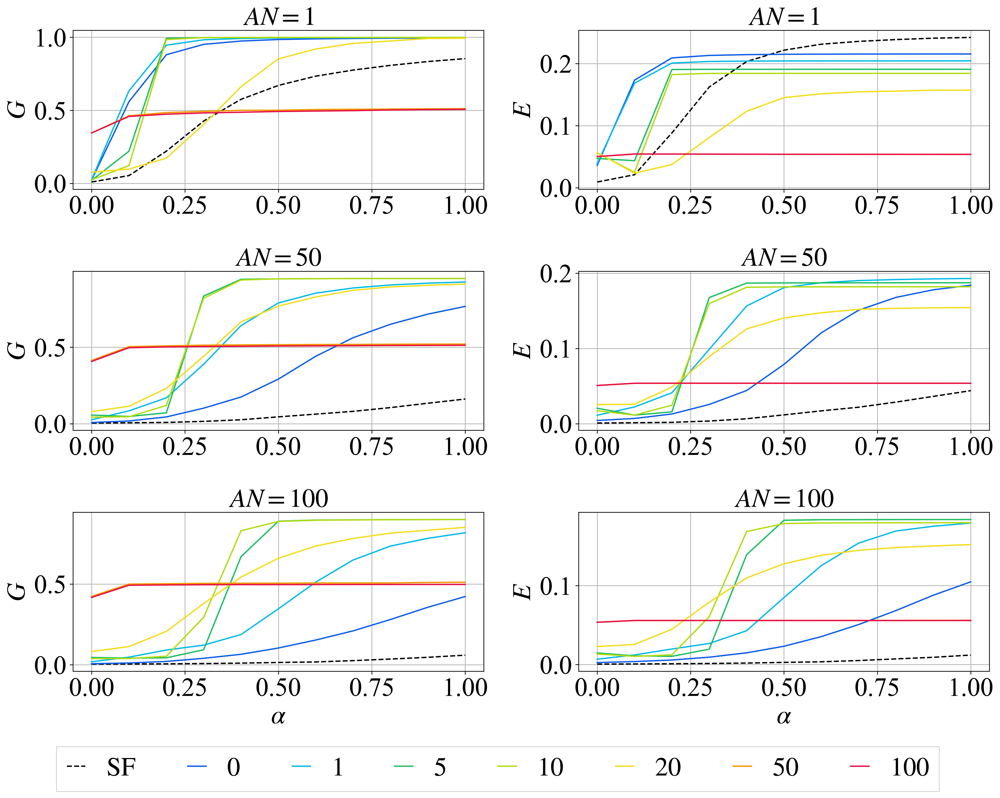

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


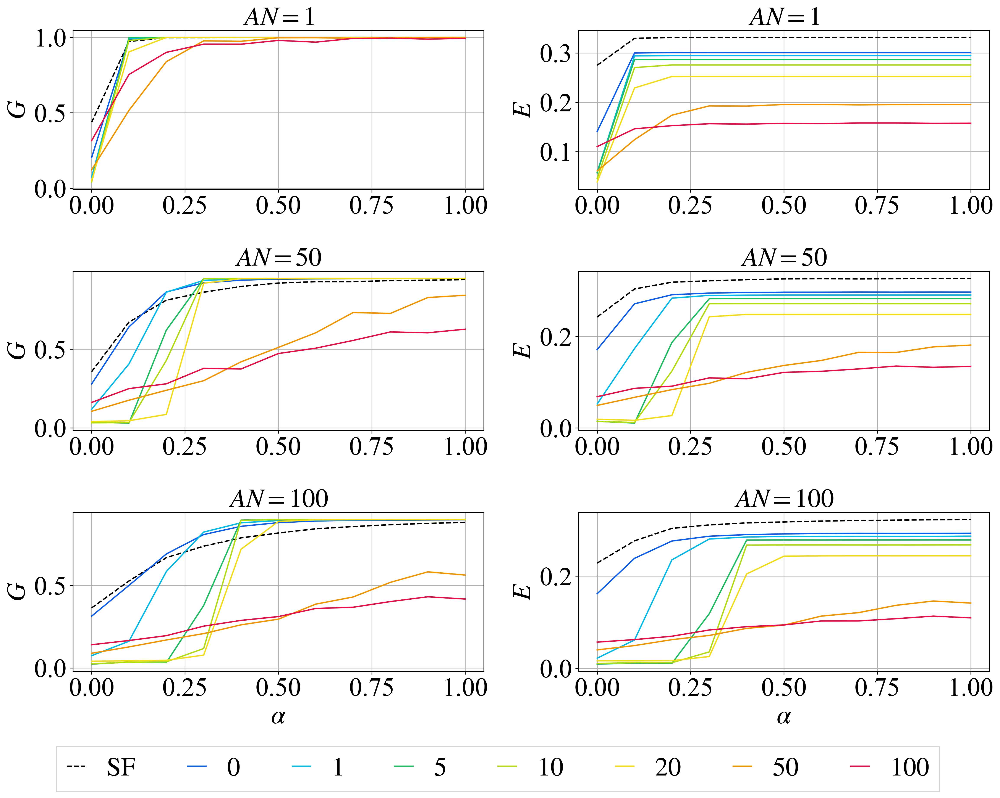

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


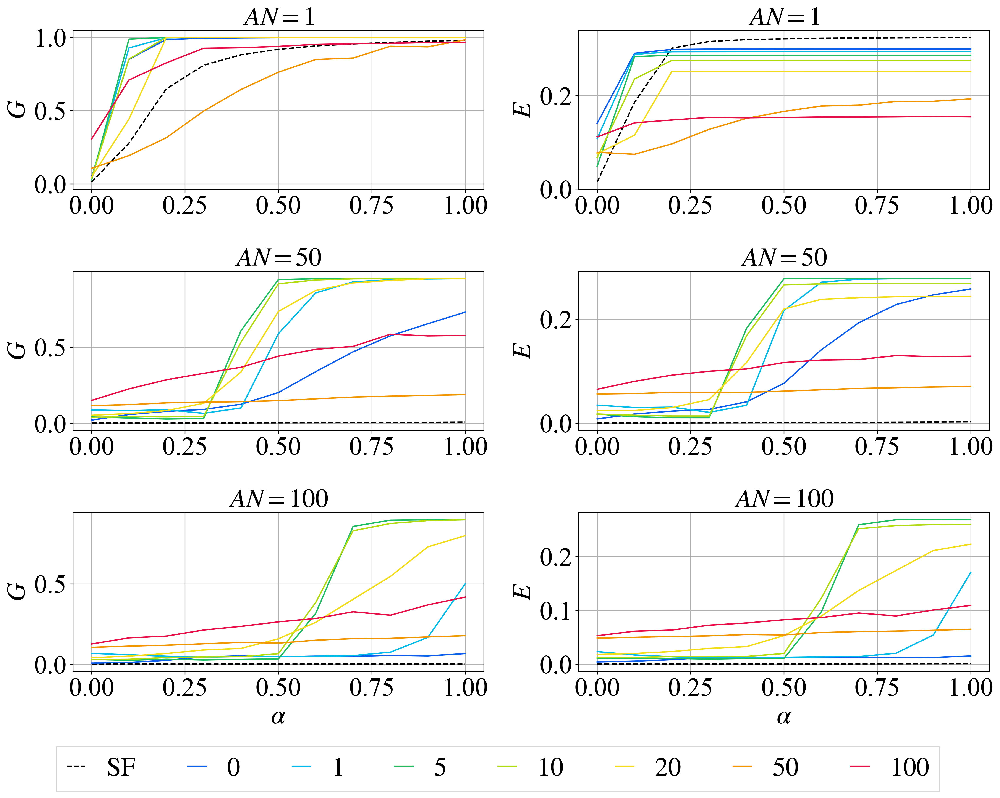

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


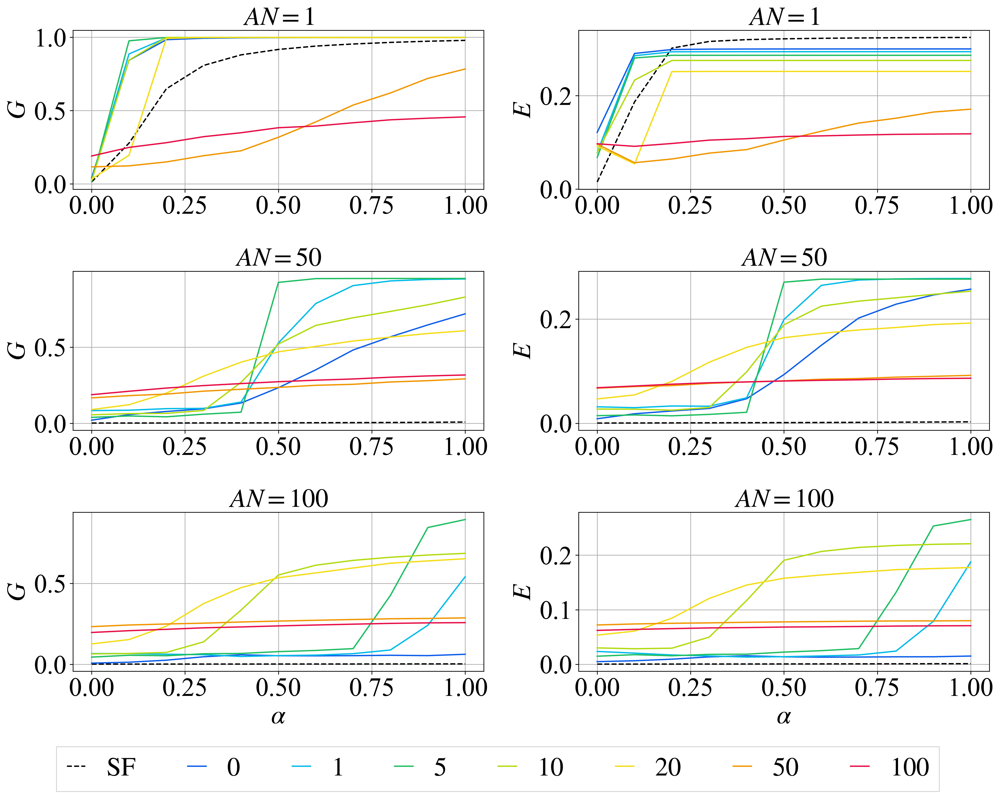

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


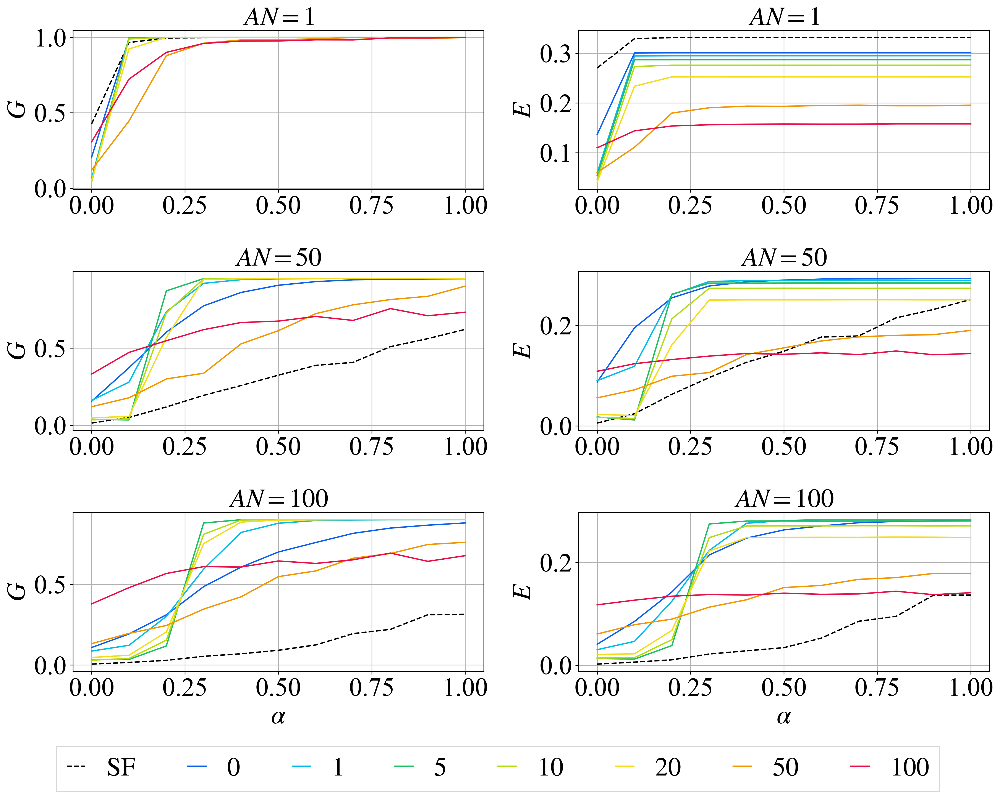

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


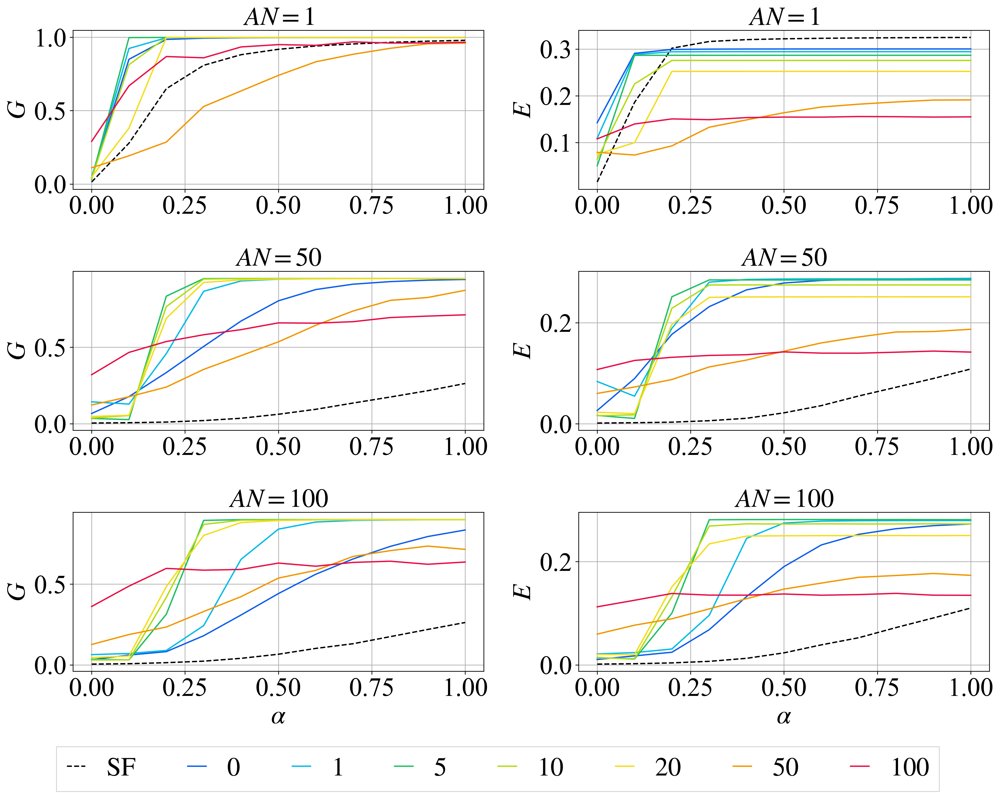

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


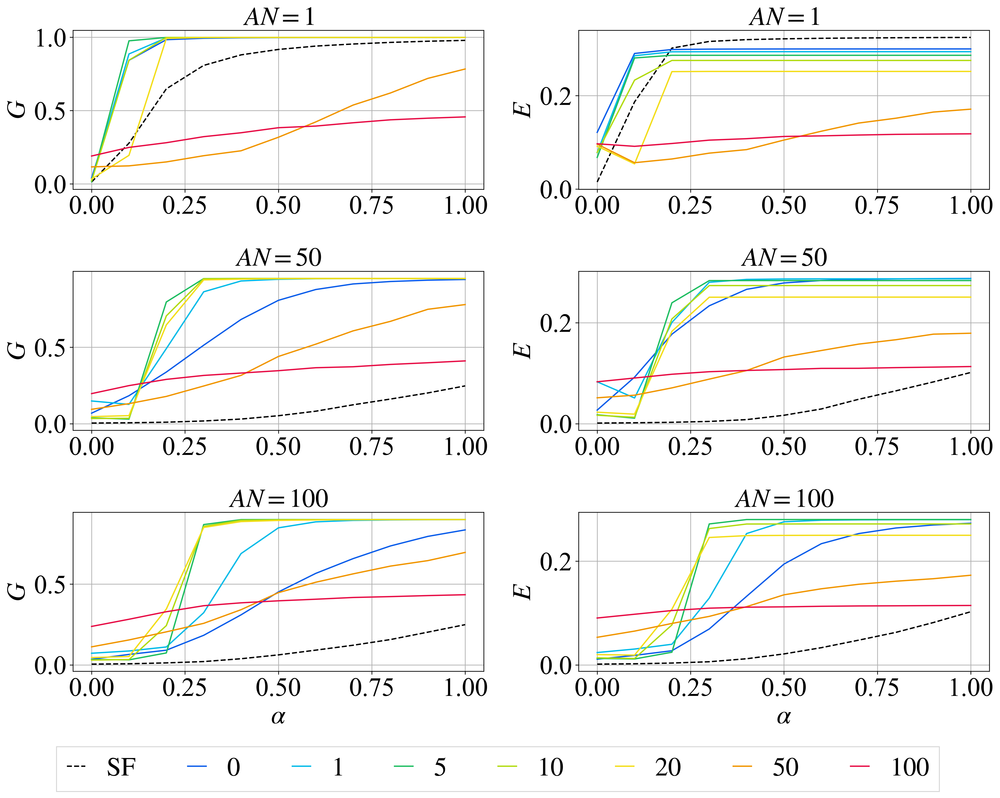

In [8]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

colors = [
    "",
    "#0d5eea",
    "#03BBE8",
    "#1FBE62",
    "#b2db11",
    "#f3dd1a",
    "#f19601",
    "#e70f47",
]

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50, 100]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

selections_of_node_removal = [
  "random",
  "k_max",
  "l_max",
  "localized_random",
  "localized_k_max",
  "localized_l_max",
]

for m, selection_of_node_removal in itertools.product(ms, selections_of_node_removal):

    _localized = True if selection_of_node_removal[0:9] == "localized" else False
    if _localized:
        _initial_node_removal = selection_of_node_removal[10:]
        _node_removal_filename = _initial_node_removal + "_localized"
    else:
        _initial_node_removal = selection_of_node_removal
        _node_removal_filename = _initial_node_removal

    tg = "R"
    tg_label = "G" if tg == "R" else "E"

    # 最大連結成分比
    ys, xs = 3, 2
    fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

    fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

    # ax[0][0].set_title("Robustness")
    # ax[0][1].set_title("Efficiency")

    for y, an in enumerate(ans):
        ax[ys-1][0].set_xlabel(r"$\alpha$")
        ax[ys-1][1].set_xlabel(r"$\alpha$")
        ax[y][0].set_ylabel(fr"$G$")
        ax[y][1].set_ylabel(fr"$E$")

        for clr_i, b in enumerate(bs):

            # R no configuration model
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
            mean = np.array(df.loc[aa, "R"]) / number_of_network
            for j in range(1, number_of_network):
                df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
                mean += np.array(df.loc[aa, "R"]) / number_of_network

            ax[y][0].set_title(fr"$AN = {an}$", fontsize=29)
            if b == 1:
                label = r"$\rm{PA(SF)}$"
            elif b == 0:
                label = r"IPA, $\beta=0$"
            else:
                label = fr"IPA, $\beta={b*-1}$"

            if b == 1:
                ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
            else:
                ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

            # E no configuration model
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
            mean = np.array(df.loc[aa, "E"]) / number_of_network
            for j in range(1, number_of_network):
                df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
                mean += np.array(df.loc[aa, "E"]) / number_of_network

            ax[y][1].set_title(fr"$AN = {an}$", fontsize=29)
            if b == 1:
                label = r"$\rm{PA(SF)}$"
            elif b == 0:
                label = r"IPA, $\beta=0$"
            else:
                label = fr"IPA, $\beta={b*-1}$"
            if b == 1:
                ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
            else:
                ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

    lines, labels = fig.axes[-1].get_legend_handles_labels()
    # ax[0][0].legend()
    fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.03), ncol=5)

    match selection_of_node_removal:
        case "random":
            title = "Random"
        case "k_max":
            title = "Max-degree"
        case "l_max":
            title = "Max-load"
        case "localized_random":
            title = "Localized random"
        case "localized_k_max":
            title = "Localized max-degree"
        case "localized_l_max":
            title = "Localized max-load"
    # fig.suptitle(f'{title} node removal', x=0.5, y=0.93, fontsize=37)

    fig.savefig(f'./img/appendix/{title.replace(" ", "_")}_RE_nocfg_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
    plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


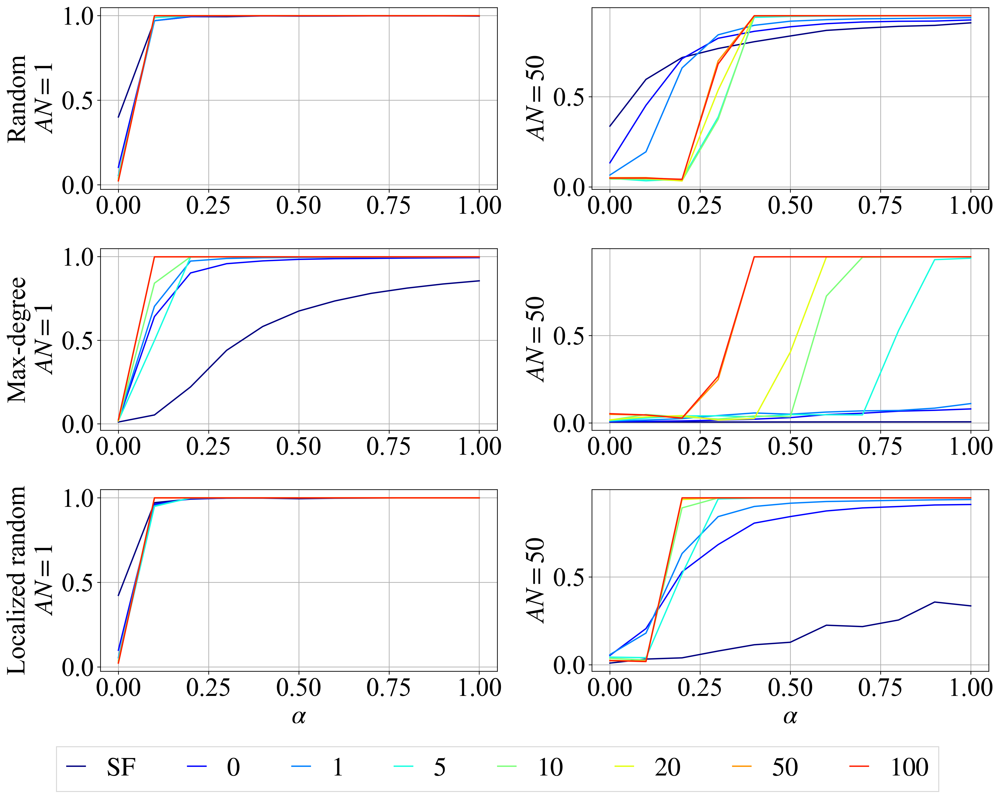

In [9]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "localized_k_max"



_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

tg = "R"
tg_label = "G" if tg == "R" else "E"

# 最大連結成分比
ys, xs = 3, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

m = ms[0]

ax[ys-1][0].set_xlabel(r"$\alpha$")
ax[ys-1][1].set_xlabel(r"$\alpha$")


###########################
# Random node removal, AN=1
ax[0][0].set_ylabel("Random""\n"fr"$AN = 1$")

# ER
# df = pd.read_csv(f"./data/ER/res/n1000/random/AN1/g_0.003974_0.csv", index_col=0)
# mean = np.array(df.loc[aa, "R"]) / number_of_network
# for j in range(1, number_of_network):
#     df = pd.read_csv(f"./data/ER/res/n1000/random/AN1/g_0.003974_{j}.csv", index_col=0)
#     mean += np.array(df.loc[aa, "R"]) / number_of_network
# ax[0][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashed", label="ER", color=cm.jet(1))

# SF, and kb atacchments
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

############################
# Random node removal, AN=50
ax[0][1].set_ylabel(fr"$AN = 50$")

# df = pd.read_csv(f"./data/ER/res/n1000/random/AN50/g_0.003974_0.csv", index_col=0)
# mean = np.array(df.loc[aa, "R"]) / number_of_network
# for j in range(1, number_of_network):
#     df = pd.read_csv(f"./data/ER/res/n1000/random/AN50/g_0.003974_{j}.csv", index_col=0)
#     mean += np.array(df.loc[aa, "R"]) / number_of_network
# ax[0][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashed", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

##########################
# k-max node removal, AN=1
ax[1][0].set_ylabel("Max-degree""\n"fr"$AN = 1$")

# df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN1/g_0.003974_0.csv", index_col=0)
# mean = np.array(df.loc[aa, "R"]) / number_of_network
# for j in range(1, number_of_network):
#     df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN1/g_0.003974_{j}.csv", index_col=0)
#     mean += np.array(df.loc[aa, "R"]) / number_of_network
# ax[1][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashed", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

###########################
# k-max node removal, AN=50
ax[1][1].set_ylabel(fr"$AN = 50$")

# df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN50/g_0.003974_0.csv", index_col=0)
# mean = np.array(df.loc[aa, "R"]) / number_of_network
# for j in range(1, number_of_network):
#     df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN50/g_0.003974_{j}.csv", index_col=0)
#     mean += np.array(df.loc[aa, "R"]) / number_of_network
# ax[1][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashed", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

##############################
# LA random node removal, AN=1
ax[2][0].set_ylabel("Localized random""\n"fr"$AN = 1$")

# df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN1/g_0.003974_0.csv", index_col=0)
# mean = np.array(df.loc[aa, "R"]) / number_of_network
# for j in range(1, number_of_network):
#     df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN1/g_0.003974_{j}.csv", index_col=0)
#     mean += np.array(df.loc[aa, "R"]) / number_of_network
# ax[2][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashed", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[2][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

###############################
# LA random node removal, AN=50
ax[2][1].set_ylabel(fr"$AN = 50$")

# df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN50/g_0.003974_0.csv", index_col=0)
# mean = np.array(df.loc[aa, "R"]) / number_of_network
# for j in range(1, number_of_network):
#     df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN50/g_0.003974_{j}.csv", index_col=0)
#     mean += np.array(df.loc[aa, "R"]) / number_of_network
# ax[2][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashed", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[2][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.03), ncol=10)

fig.savefig(f'./img/Rob_config_150_R_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


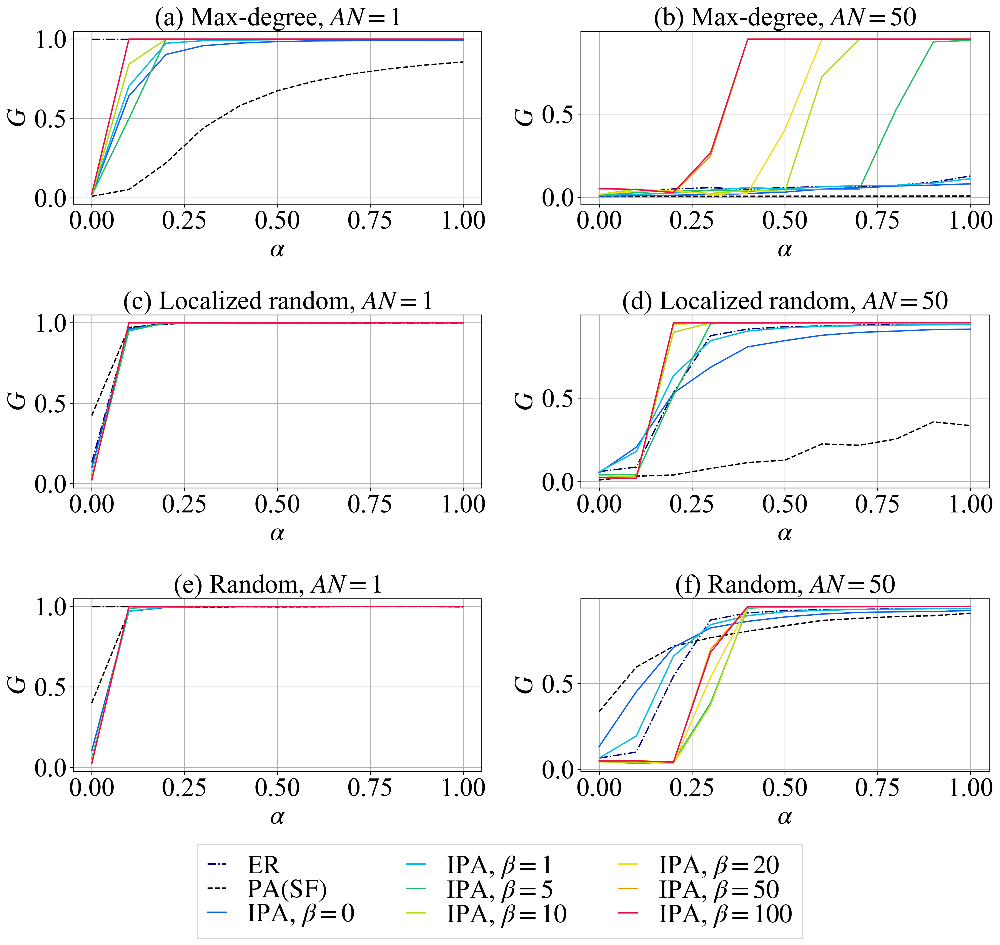

In [3]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "localized_k_max"



_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [
    "",
    "#0d5eea",
    "#03BBE8",
    "#1FBE62",
    "#b2db11",
    "#f3dd1a",
    "#f19601",
    "#e70f47",
]

tg = "R"
tg_label = "G" if tg == "R" else "E"

t = "R"

# 最大連結成分比
ys, xs = 3, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4.5*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

m = ms[0]

[ax[i, j].set_xlabel(r"$\alpha$") for i in range(len(ax)) for j in range(len(ax[0]))]
[ax[i, j].set_ylabel(r"$G$") for i in range(len(ax)) for j in range(len(ax[0]))]
# ax[ys-1][1].set_xlabel(r"$\alpha$")


###########################
# Random node removal, AN=1
ax[2][0].set_title("(e) Random, "fr"$AN = 1$", fontsize=29)

# ER
df = pd.read_csv(f"./data/ER/res/n1000/random/AN1/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, t]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/random/AN1/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, t]) / number_of_network
ax[2][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color="black")

# SF, and kb atacchments
for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA(SF)}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"{t}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[2][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[2][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

############################
# Random node removal, AN=50
ax[2][1].set_title("(f) Random, "fr"$AN = 50$", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/random/AN50/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, t]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/random/AN50/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, t]) / number_of_network
ax[2][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA(SF)}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"{t}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[2][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[2][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

##########################
# k-max node removal, AN=1
ax[0][0].set_title("(a) Max-degree, "fr"$AN = 1$", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN1/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, t]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN1/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, t]) / number_of_network
ax[0][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA(SF)}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"{t}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[0][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[0][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

###########################
# k-max node removal, AN=50
ax[0][1].set_title("(b) Max-degree, "fr"$AN = 50$", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN50/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, t]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/k_max/AN50/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, t]) / number_of_network
ax[0][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA(SF)}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"{t}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[0][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[0][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

##############################
# LA random node removal, AN=1
ax[1][0].set_title("(c) Localized random, "fr"$AN = 1$", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN1/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, t]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN1/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, t]) / number_of_network
ax[1][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA(SF)}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"{t}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[1][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[1][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

###############################
# LA random node removal, AN=50
ax[1][1].set_title("(d) Localized random, "fr"$AN = 50$", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN50/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, t]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN50/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, t]) / number_of_network
ax[1][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA(SF)}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"

    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"{t}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[1][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[1][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.03), ncol=3)
fig.savefig(f'./img/tolerance.eps', bbox_inches="tight", pad_inches=0.05)
plt.subplots_adjust(wspace=0.2, hspace=0.5)
plt.show()

# Slide用の画像

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


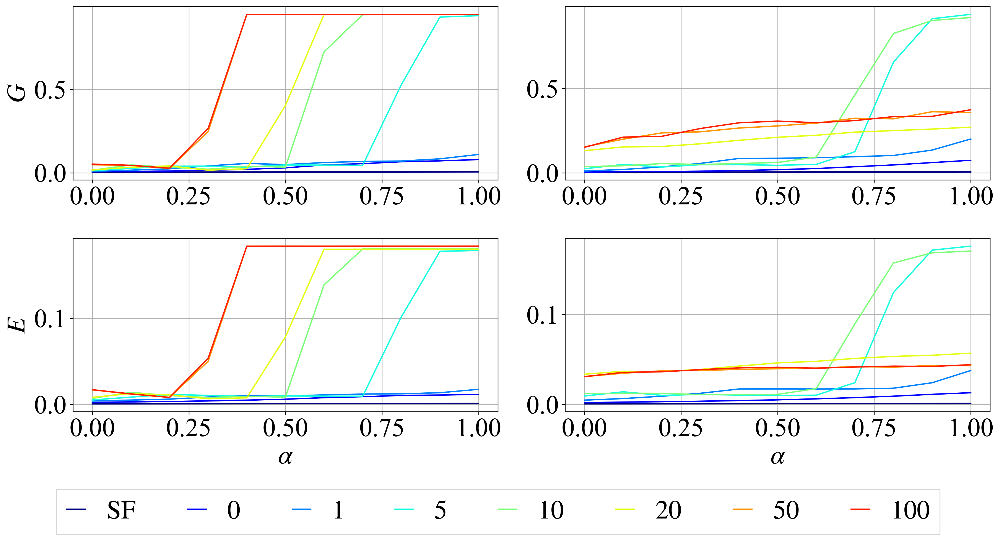

In [3]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "k_max"

_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

tg = "R"
tg_label = "G" if tg == "R" else "E"

# 最大連結成分比
ys, xs = 2, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

for y, (m, an) in enumerate(itertools.product(ms, ans)):
    ax[ys-1][0].set_xlabel(r"$\alpha$")
    ax[ys-1][1].set_xlabel(r"$\alpha$")
    ax[y][0].set_ylabel(fr"${tg_label}$")

    for clr_i, b in enumerate(bs):
        label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"

        # apply configuration model
        if _localized:
            df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        else:
            df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        mean = [sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
        ax[y][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

        # no configuration model
        df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
        mean = np.array(df.loc[aa, tg]) / number_of_network
        for j in range(1, number_of_network):
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
            mean += np.array(df.loc[aa, tg]) / number_of_network
        ax[y][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

tg = "E"
tg_label = "G" if tg == "R" else "E"

for y, (m, an) in enumerate(itertools.product(ms, ans)):
    ax[ys-1][0].set_xlabel(r"$\alpha$")
    ax[ys-1][1].set_xlabel(r"$\alpha$")
    ax[y+len(ans)][0].set_ylabel(fr"${tg_label}$")

    for clr_i, b in enumerate(bs):
        label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"

        # apply configuration model
        if _localized:
            df = pd.read_csv(f"./data/result_localized_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        else:
            df = pd.read_csv(f"./data/result_config/result_n{node_size}_m{m}_{_initial_node_removal}_b{b}_AN{an}.csv", index_col=0)
        mean = [sum([df.loc[a, f"{tg}_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
        ax[y+len(ans)][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

        # no configuration model
        df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_0.csv", index_col=0)
        mean = np.array(df.loc[aa, tg]) / number_of_network
        for j in range(1, number_of_network):
            df = pd.read_csv(f"./data/result2/cf_n{node_size}_m{m}_b{b}_{_node_removal_filename}_AN{an}_no_config_{j}.csv", index_col=0)
            mean += np.array(df.loc[aa, tg]) / number_of_network
        ax[y+len(ans)][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

lines, labels = fig.axes[-1].get_legend_handles_labels()
# ax[0][0].legend()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.04), ncol=8)

match selection_of_node_removal:
    case "random":
        title = "Random"
    case "k_max":
        title = "Max-degree"
    case "l_max":
        title = "Max-load"
    case "localized_random":
        title = "Localized random"
    case "localized_k_max":
        title = "Localized max-degree"
    case "localized_l_max":
        title = "Localized max-load"
# fig.suptitle(f'{title} node removal', x=0.5, y=0.96, fontsize=37)

fig.patch.set_alpha(0)
fig.savefig(f'./img/slide/config_or_noconfig_{title.replace(" ", "_")}_GE_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


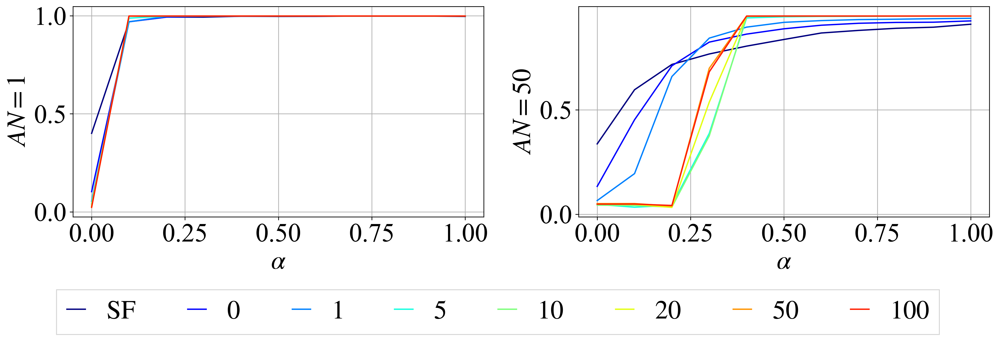

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


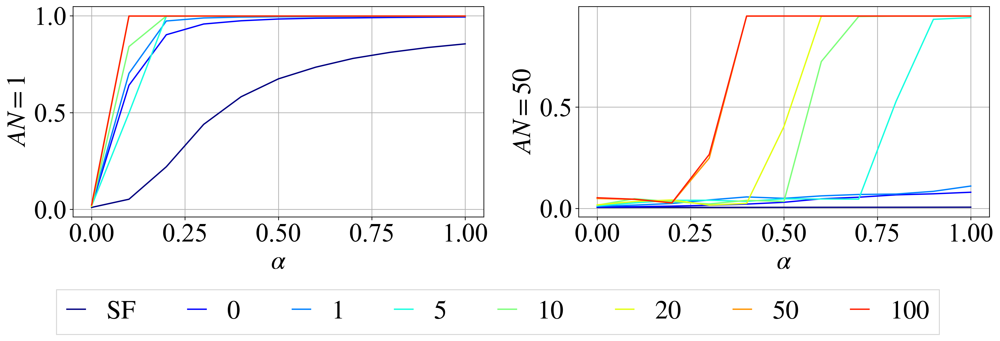

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


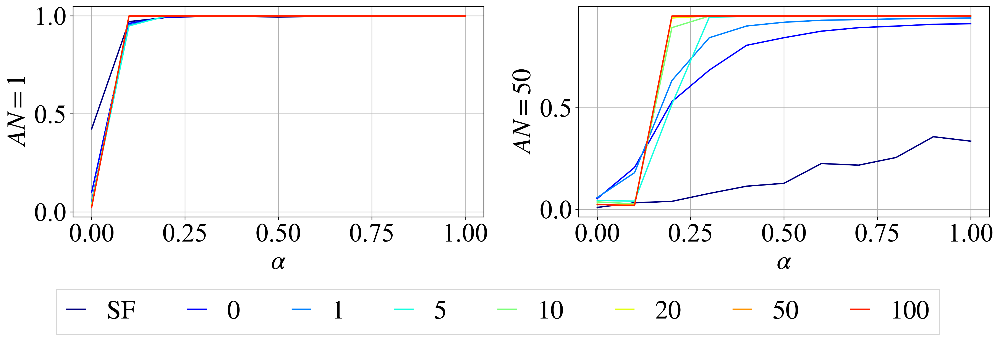

In [11]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "localized_k_max"



_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

tg = "R"
tg_label = "G" if tg == "R" else "E"

ys, xs = 1, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))
fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)
m = ms[0]
ax[0].set_xlabel(r"$\alpha$")
ax[1].set_xlabel(r"$\alpha$")
ax[0].set_ylabel(fr"$AN = 1$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])
ax[1].set_ylabel(fr"$AN = 50$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])
lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.08), ncol=8)
fig.patch.set_alpha(0)
fig.savefig(f'./img/slide/Rob_config_150_Random_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

ys, xs = 1, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))
fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)
m = ms[0]
ax[0].set_xlabel(r"$\alpha$")
ax[1].set_xlabel(r"$\alpha$")
ax[0].set_ylabel(fr"$AN = 1$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])
ax[1].set_ylabel(fr"$AN = 50$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])
lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.08), ncol=8)
fig.patch.set_alpha(0)
fig.savefig(f'./img/slide/Rob_config_150_Max-degree_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

ys, xs = 1, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))
fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)
m = ms[0]
ax[0].set_xlabel(r"$\alpha$")
ax[1].set_xlabel(r"$\alpha$")
ax[0].set_ylabel(fr"$AN = 1$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])
ax[1].set_ylabel(fr"$AN = 50$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"R_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])
lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.08), ncol=8)
fig.patch.set_alpha(0)
fig.savefig(f'./img/slide/Rob_config_150_LArandom_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


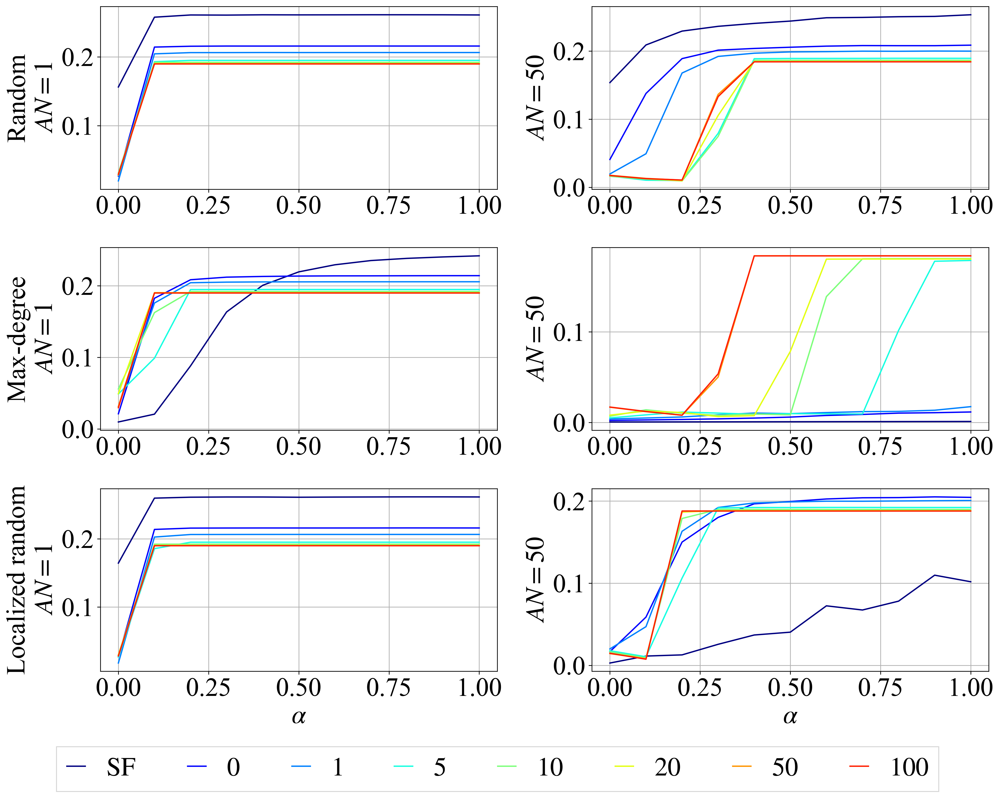

In [16]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# choose from [
#   random,
#   k_max,
#   l_max,
#   localized_random,
#   localized_k_max,
#   localized_l_max,
# ]
selection_of_node_removal = "localized_k_max"



_localized = True if selection_of_node_removal[0:9] == "localized" else False
if _localized:
    _initial_node_removal = selection_of_node_removal[10:]
    _node_removal_filename = _initial_node_removal + "_localized"
else:
    _initial_node_removal = selection_of_node_removal
    _node_removal_filename = _initial_node_removal

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [hsv_to_rgb(c1_h - i * g, 0.9, 1.0) for i in range(len(bs))]

tg = "E"
tg_label = "G" if tg == "R" else "E"

# 最大連結成分比
ys, xs = 3, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 4*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

m = ms[0]

ax[ys-1][0].set_xlabel(r"$\alpha$")
ax[ys-1][1].set_xlabel(r"$\alpha$")

ax[0][0].set_ylabel("Random""\n"fr"$AN = 1$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

ax[0][1].set_ylabel(fr"$AN = 50$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[0][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

ax[1][0].set_ylabel("Max-degree""\n"fr"$AN = 1$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

ax[1][1].set_ylabel(fr"$AN = 50$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[1][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

# ax[2][0].tick_params(labelbottom=False, labelleft=False)
# ax[2][0].grid(color="white")
# ax[2][0].tick_params(colors="white")
ax[2][0].set_ylabel("Localized random""\n"fr"$AN = 1$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN1.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[2][0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

ax[2][1].set_ylabel(fr"$AN = 50$")
for clr_i, b in enumerate(bs):
    label = fr"IPA, $\beta={b*-1}$" if not b == 1 else r"$\rm{SF}$"
    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    ax[2][1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.03), ncol=8)
fig.patch.set_alpha(0)
fig.savefig(f'./img/slide/Rob_config_150_E_m{m}.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


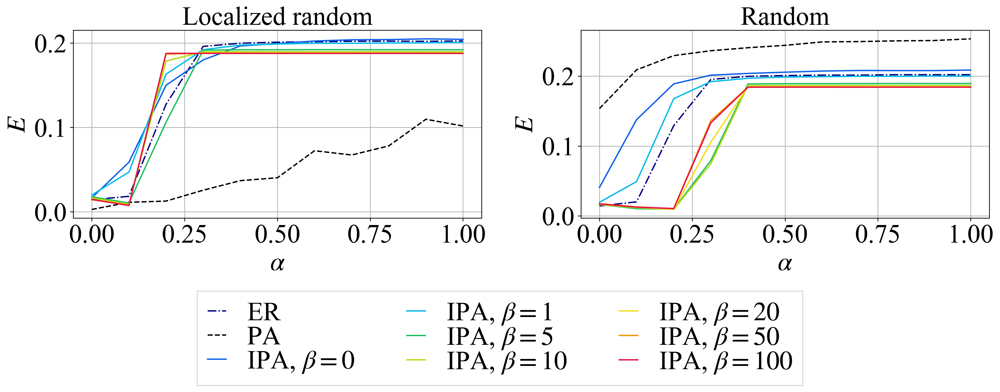

In [2]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import numpy as np
from colorsys import hsv_to_rgb

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 29
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 29
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [
    "",
    "#0d5eea",
    "#03BBE8",
    "#1FBE62",
    "#b2db11",
    "#f3dd1a",
    "#f19601",
    "#e70f47",
]

tg = "E"
tg_label = "G" if tg == "R" else "E"

# 最大連結成分比
ys, xs = 1, 2
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

m = ms[0]

ax[0].set_xlabel(r"$\alpha$")
ax[1].set_xlabel(r"$\alpha$")

ax[0].set_ylabel(r"$E$")
ax[1].set_ylabel(r"$E$")

ax[1].set_title("Random", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/random/AN50/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, "E"]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/random/AN50/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, "E"]) / number_of_network
ax[1].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"

    # R apply configuration model
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[1].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])


ax[0].set_title("Localized random", fontsize=29)

df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN50/g_0.003974_0.csv", index_col=0)
mean = np.array(df.loc[aa, "E"]) / number_of_network
for j in range(1, number_of_network):
    df = pd.read_csv(f"./data/ER/res/n1000/random_localized/AN50/g_0.003974_{j}.csv", index_col=0)
    mean += np.array(df.loc[aa, "E"]) / number_of_network
ax[0].plot(np.arange(0, 1.1, 0.1), mean, marker="", linestyle="dashdot", label="ER", color=cm.jet(1))

for clr_i, b in enumerate(bs):
    if b == 1:
        label = r"$\rm{PA}$"
    elif b == 0:
        label = r"IPA, $\beta=0$"
    else:
        label = fr"IPA, $\beta={b*-1}$"

    # R apply configuration model
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = [sum([df.loc[a, f"E_{i}"] for i in range(number_of_network)]) / number_of_network for a in aa]
    if b == 1:
        ax[0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, linestyle="dashed", color="black")
    else:
        ax[0].plot(np.arange(0, 1.1, 0.1), mean, marker="", label=label, color=colors[clr_i])

lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.08), ncol=3)
fig.patch.set_alpha(0)
fig.savefig(f'./img/efficiency.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()

# Βパラメータごとに故障前と故障後α=1のE値を比較

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


8 [0.2613991202654824, 0.21727427209811848, 0.2065123438791961, 0.19511690707433077, 0.19223740774165252, 0.19057079520848394, 0.18997120876489793, 0.1899529976887419]


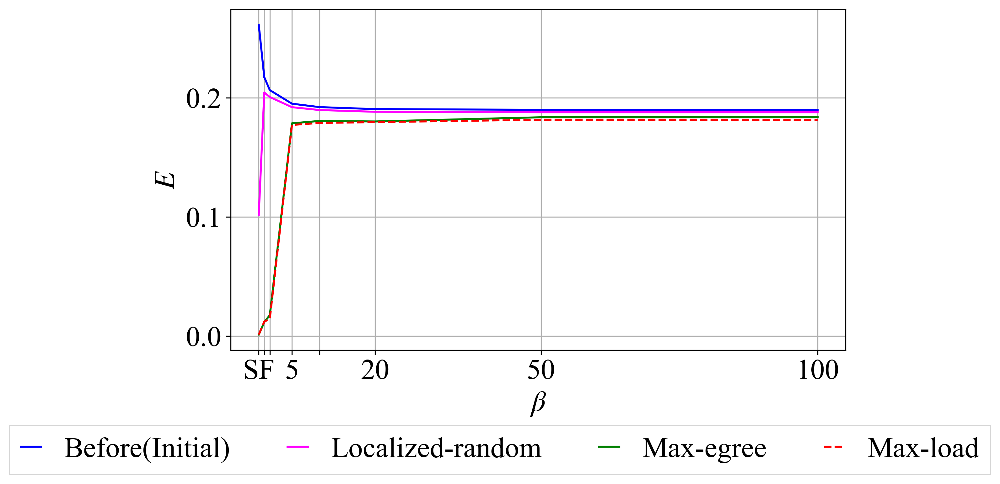

In [7]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from tqdm import tqdm
import pandas as pd
import networkx as nx
import numpy as np
from colorsys import hsv_to_rgb

def graph_from_netfile(path):
    with open(path, "r") as f:
        lines = [l.replace("\n", "").split() for l in f.readlines()]
        G = nx.Graph()
        for i, edge in enumerate(lines):
            if i == 0 or i == 1:
                continue
            G.add_edge(edge[0], edge[1])
    return G

def efficiency(G):
    shortest_path_length_dict = nx.shortest_path_length(G)

    sum_ = 0
    for spl in shortest_path_length_dict:
        origin, targets = spl
        for i, l in targets.items():
            if l == 0:
                continue
            sum_ += 1 / l

    N = nx.number_of_nodes(G)
    if N == 0:
        return 0

    return (1 / (N * (N - 1))) * (sum_)

# グラフの設定
plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["mathtext.fontset"] = "stix"

plt.rcParams["font.size"] = 22
plt.rcParams["axes.grid"] = True
plt.rcParams['figure.dpi'] = 300
plt.rcParams["legend.fontsize"] = 22
plt.rcParams["legend.fancybox"] = False
plt.rcParams["legend.markerscale"] = 1
plt.rcParams["legend.handlelength"] = 0.7
plt.rcParams["legend.labelspacing"] = 0
plt.rcParams["legend.handletextpad"] = 0.8

aa = np.arange(0, 1.1, 0.1)
aa = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

number_of_network = 100
node_size = 1000
ms = [2]
ans = [1, 50]
bs = [1, 0, -1, -5, -10, -20, -50, -100]

# gradation
c1_h = 358 / 360
c2_h = 224 / 360
g = (c1_h - c2_h) / len(bs)
colors = [
    "",
    "#0d5eea",
    "#03BBE8",
    "#1FBE62",
    "#b2db11",
    "#f3dd1a",
    "#f19601",
    "#e70f47",
]

# 最大連結成分比
ys, xs = 1, 1
fig, ax = plt.subplots(ys, xs, tight_layout=True, figsize=(8*xs, 5*ys))

fig.subplots_adjust(bottom=0.2, left=0.18, top=0.99, right=0.96)

m = ms[0]

ax.set_xlabel(r"$\beta$")
ax.set_ylabel(r"$E$")
# ax.set_title("Random", fontsize=29)

E_before_cf_list = []
E_after_cf_random_list = []
E_after_cf_k_max_list = []
E_after_cf_l_max_list = []
for b in bs:
    # Before cascading failures
    # E = 0
    # for i in tqdm(range(100)):
    #     netfile = f"./data/network/net_n1000_m2_b{b}/link{i}.net"
    #     G = graph_from_netfile(netfile)
    #     E += efficiency(G) / 100
    # E_before_cf_list.append(E)

    # After cascading failures random
    # df = pd.read_csv(f"./data/result_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    # mean = sum([df.loc[1, f"E_{i}"] for i in range(number_of_network)]) / number_of_network
    # E_after_cf_random_list.append(mean)

    # After cascading failures localized random
    df = pd.read_csv(f"./data/result_localized_config/result_n1000_m2_random_b{b}_AN50.csv", index_col=0)
    mean = sum([df.loc[1, f"E_{i}"] for i in range(number_of_network)]) / number_of_network
    E_after_cf_random_list.append(mean)

    # After cascading failures k-max
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_k_max_b{b}_AN50.csv", index_col=0)
    mean = sum([df.loc[1, f"E_{i}"] for i in range(number_of_network)]) / number_of_network
    E_after_cf_k_max_list.append(mean)

    # After cascading failures l-max
    df = pd.read_csv(f"./data/result_config/result_n1000_m2_l_max_b{b}_AN50.csv", index_col=0)
    mean = sum([df.loc[1, f"E_{i}"] for i in range(number_of_network)]) / number_of_network
    E_after_cf_l_max_list.append(mean)

E_before_cf_list = [0.2613991202654824, 0.21727427209811848, 0.2065123438791961, 0.19511690707433077, 0.19223740774165252, 0.19057079520848394, 0.18997120876489793, 0.1899529976887419,]

bs = [-b for b in bs]

print(len(E_before_cf_list), E_before_cf_list)
ax.plot(bs, E_before_cf_list, label="Before(Initial)", color='blue')
ax.plot(bs, E_after_cf_random_list, label="Localized-random", color='magenta')
ax.plot(bs, E_after_cf_k_max_list, label="Max-egree", color='green')
ax.plot(bs, E_after_cf_l_max_list, label="Max-load", color='red', linestyle='--')

bs_tick = ["SF", "0", "", "5", "", "20", "50", "100"]

plt.xticks([100, 50, 20, 10, 5, 1, 0, -1], [100, 50, 20, "", 5, "", "", "SF"])

lines, labels = fig.axes[-1].get_legend_handles_labels()
fig.legend(lines, labels, loc = 'upper center', bbox_to_anchor=(0.5, 0.08), ncol=4)
fig.patch.set_alpha(0)
fig.savefig(f'./img/efficiency2.eps', bbox_inches="tight", pad_inches=0.05)
plt.show()